In [41]:
import os
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import keras
import pickle

from keras import backend as K
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.initializers import Ones, Zeros, Constant
from keras.models import Model, load_model
from keras.layers import Dense, Input, Lambda, SimpleRNN, Reshape, RepeatVector, PReLU, BatchNormalization, LeakyReLU
from keras.losses import mse
from keras.constraints import non_neg

In [42]:
# Change presentation settings

%matplotlib inline

matplotlib.rcParams["figure.figsize"] = (16.0, 10.0)

#matplotlib.rcParams['font.family'] = 'sans-serif'
#matplotlib.rcParams['font.sans-serif'] = ['Liberation Sans']

matplotlib.rcParams["axes.spines.left"] = True
matplotlib.rcParams["axes.spines.top"] = True
matplotlib.rcParams["axes.spines.right"] = True
matplotlib.rcParams["axes.spines.bottom"] = True
matplotlib.rcParams["axes.labelsize"] = 14
matplotlib.rcParams["axes.titlesize"] = 18

matplotlib.rcParams["xtick.top"] = True
matplotlib.rcParams["ytick.right"] = True
matplotlib.rcParams["xtick.direction"] = "in"
matplotlib.rcParams["ytick.direction"] = "in"
matplotlib.rcParams["xtick.labelsize"] = 16
matplotlib.rcParams["ytick.labelsize"] = 16
matplotlib.rcParams["xtick.major.size"] = 16
matplotlib.rcParams["ytick.major.size"] = 16
matplotlib.rcParams["xtick.minor.size"] = 16
matplotlib.rcParams["ytick.minor.size"] = 16
matplotlib.rcParams["xtick.minor.visible"] = True

matplotlib.rcParams["lines.linewidth"] = 2

matplotlib.rcParams["legend.fontsize"] = 14

color_palette = {"Indigo": {
                    50: "#E8EAF6",
                    100: "#C5CAE9",
                    200: "#9FA8DA",
                    300: "#7986CB",
                    400: "#5C6BC0",
                    500: "#3F51B5",
                    600: "#3949AB",
                    700: "#303F9F",
                    800: "#283593",
                    900: "#1A237E"},
                 "Orange": {      
                    50: "#FFF3E0",
                    100: "#FFE0B2",
                    200: "#FFCC80",
                    300: "#FFB74D",
                    400: "#FFA726",
                    500: "#FF9800",
                    600: "#FB8C00",
                    700: "#F57C00",
                    800: "#EF6C00",
                    900: "#E65100"}
                }

line_styles = [(0, ()), (0, (1, 2)), (0, (3, 2))]

In [45]:
model_name = "normedRateAvg304125"
good_data_file = "PileupNewData_data.pickle"
bad_data_file = "PileupNewData_bad.pickle"

with open(good_data_file, 'rb') as handle:
    good_data = pickle.load(handle)
with open(bad_data_file, 'rb') as handle:
    bad_data = pickle.load(handle)
    
model = load_model("%s.h5" % (model_name))
num_rates = 6

In [46]:
mean_per_part = []
stdd_per_part = []

mean_max = []
stdd_max = []

mean_square = []
stdd_square = []

runs = []

labels = []
lumis = []
lumi_errors = []
lumi_errors_mean = []
lumi_errors_square = []

for i in range(num_rates):
    mean_per_part.append([])
    stdd_per_part.append([])

c = 0
for key in good_data.keys():
    if key != "HLT" and key != 'Eras':
        runs.append(key)
        
        sample = good_data[key]["samples"]
        new_sample = []
        
        labels.append(good_data[key]["labels"])
        lumis.append(good_data[key]["lumiid"])
        new_labels = []
        new_lumis = []
                
        for s in range(len(sample)):
            if 0 not in sample[s]:
                new_sample.append(sample[s])
                new_labels.append(labels[c][s])
                new_lumis.append(lumis[c][s])
                
        labels[c] = new_labels
        lumis[c] = new_lumis
                
        sample = new_sample
        
        reconstructed = model.predict(np.array(sample))
        
        relative_error = abs(sample-reconstructed)/sample
        
        max_error = []
        error_reformat = []
        
        for i in range(num_rates):
            error_reformat.append([])

        for i in range(len(relative_error)):
            max_error.append(max(relative_error[i]))
            for j in range(num_rates):
                error_reformat[j].append(relative_error[i][j])
        
        error = []
        for r in range(len(reconstructed)):
            temp = 0
            for s in range(len(reconstructed[r])):
                temp+=(reconstructed[r][s]-sample[r][s])**2
            error.append(temp)
            
        # Relative Error Per HLT Part Calculations
        for i in range(num_rates):
            mean_per_part[i].append(np.mean(error_reformat[i]))
            stdd_per_part[i].append(np.std(error_reformat[i]))
        
        # Max Rel Error Calculations
        mean_max.append(np.mean(max_error))
        stdd_max.append(np.std(max_error))
        
        # Sum of Sq.Diff Error Calculations
        mean_square.append(np.mean(error))
        stdd_square.append(np.std(error))
        
        # Lumisection and error
        lumi_errors.append([])
        lumi_errors_mean.append([])
        lumi_errors_square.append([])
        for err in relative_error:
            lumi_errors[c].append(max(err))
            lumi_errors_mean[c].append(np.mean(err))
            lumi_errors_square[c] = np.array(error)/6
        c += 1
        
num_good_runs = c

for key in bad_data.keys():
    if key != "HLT" and key != 'Eras':
        
        sample = bad_data[key]["samples"]

        if len(sample) > 0:
            
            runs.append(key)

            labels.append(bad_data[key]["labels"])
            lumis.append(bad_data[key]["lumiid"])
            reconstructed = model.predict(np.array(sample))

            relative_error = (np.array(sample)-reconstructed)/(abs(np.array(sample))+abs(reconstructed))

            max_error = []
            error_reformat = []

            for i in range(num_rates):
                error_reformat.append([])

            for i in range(len(relative_error)):
                max_error.append(max(relative_error[i]))
                for j in range(num_rates):
                    error_reformat[j].append(relative_error[i][j])

            error = []
            for r in range(len(reconstructed)):
                temp = 0
                for s in range(len(reconstructed[r])):
                    temp+=(reconstructed[r][s]-sample[r][s])**2
                error.append(temp)

            # Relative Error Per HLT Part Calculations
            for i in range(num_rates):
                mean_per_part[i].append(np.mean(error_reformat[i]))
                stdd_per_part[i].append(np.std(error_reformat[i]))

            # Max Rel Error Calculations
            mean_max.append(np.mean(max_error))
            stdd_max.append(np.std(max_error))

            # Sum of Sq.Diff Error Calculations
            mean_square.append(np.mean(error))
            stdd_square.append(np.std(error))

            # Lumisection and error
            lumi_errors.append([])
            lumi_errors_mean.append([])
            lumi_errors_square.append([])
            for err in relative_error:
                lumi_errors[c].append(max(err))
                lumi_errors_mean[c].append(np.mean(err))
                lumi_errors_square[c] = np.array(error)/6
            c += 1

In [47]:
print(c,len(good_data.keys())-1)

304 232


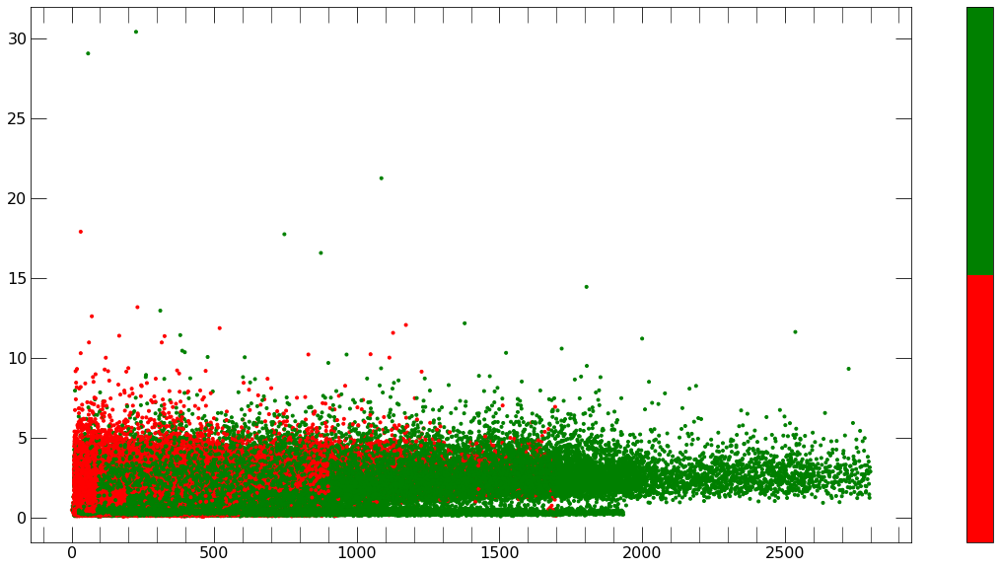

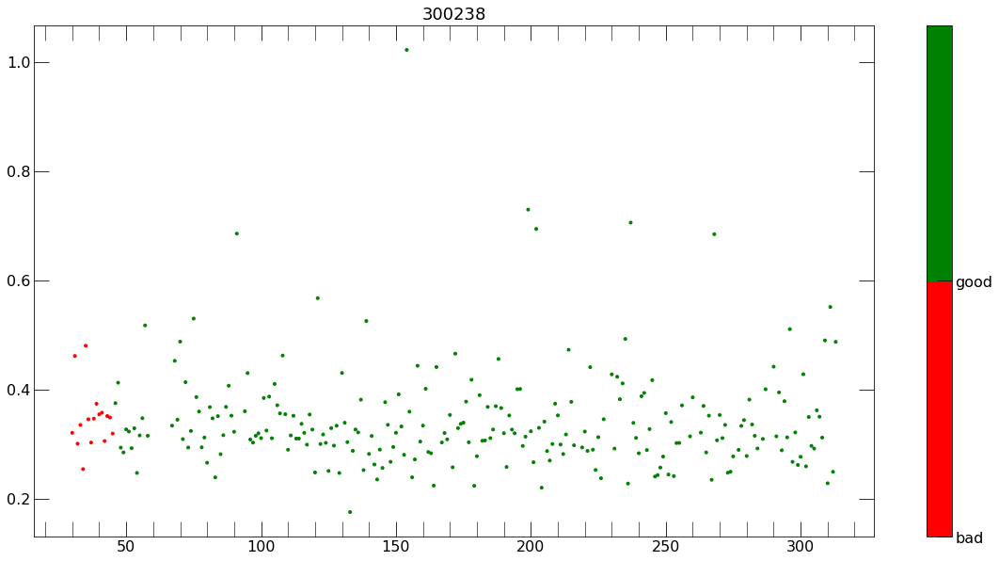

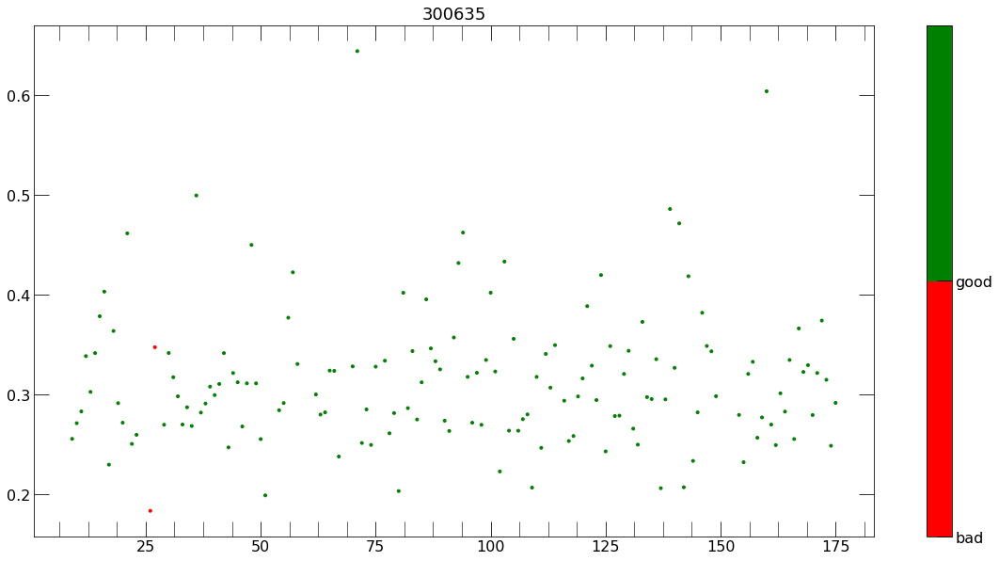

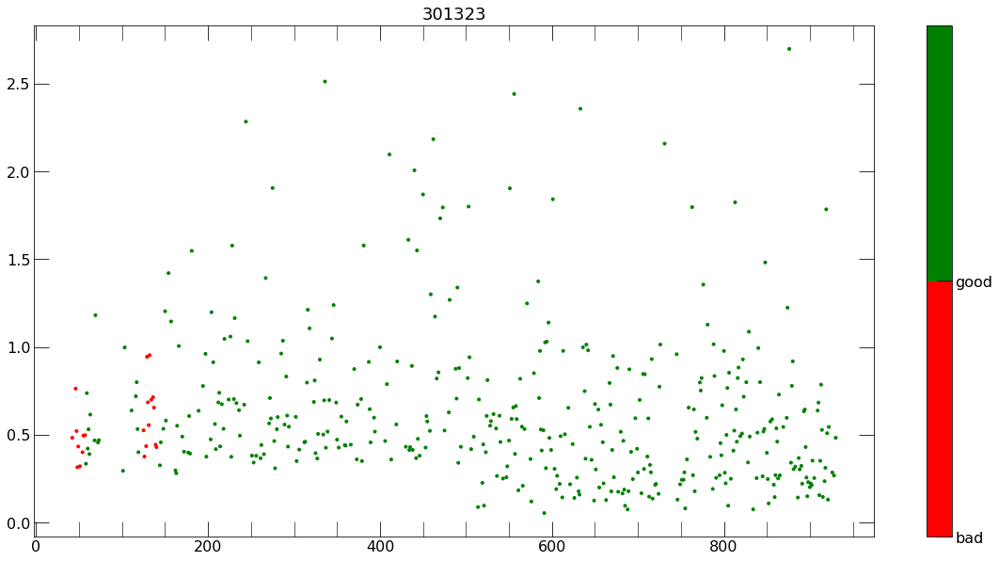

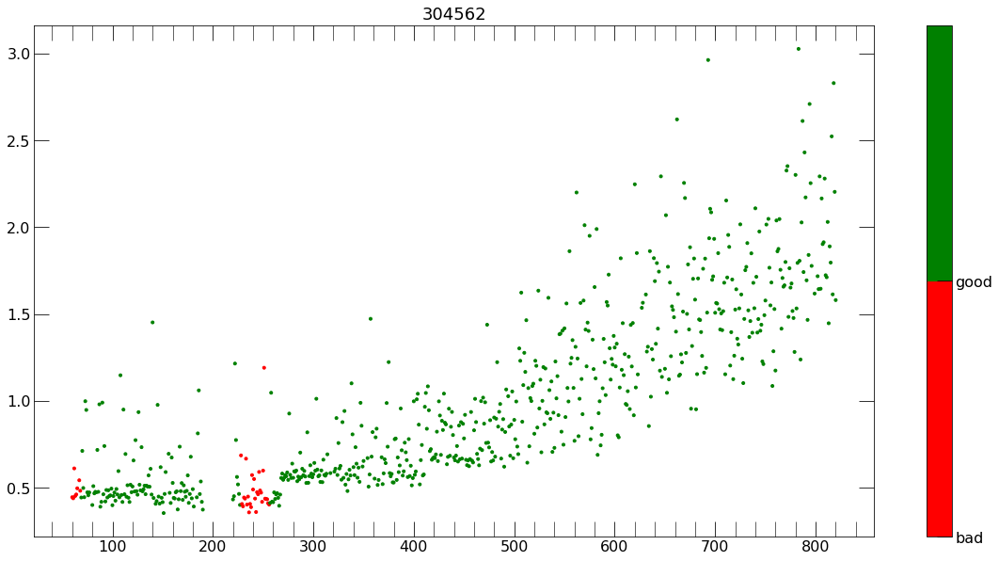

...

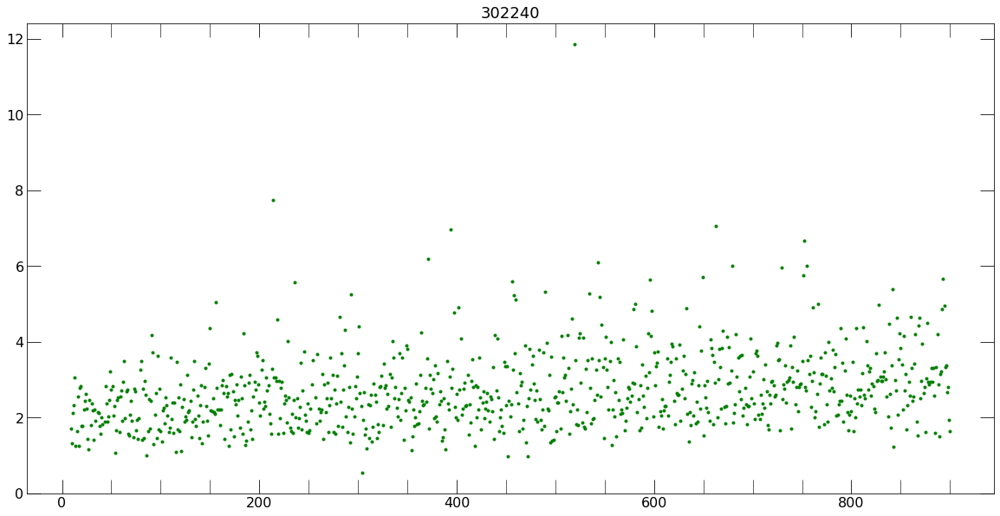

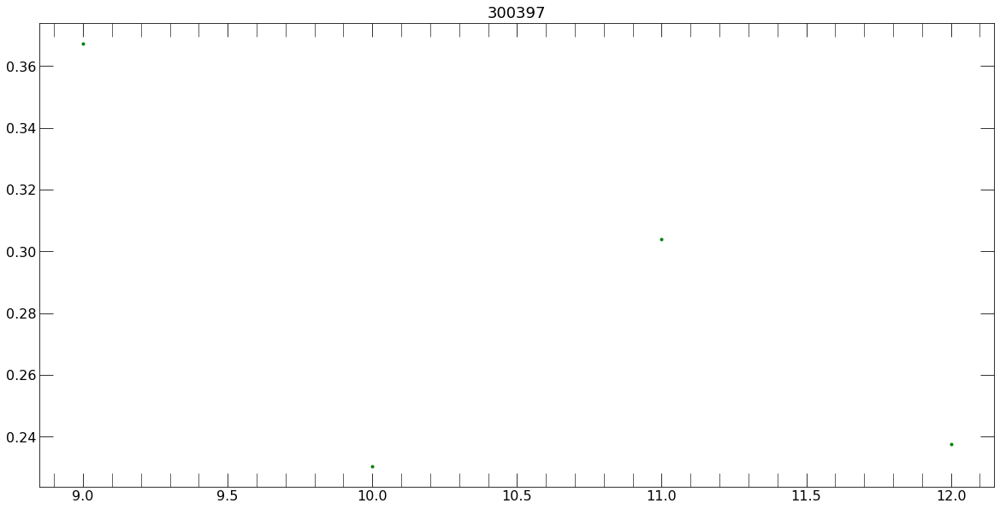

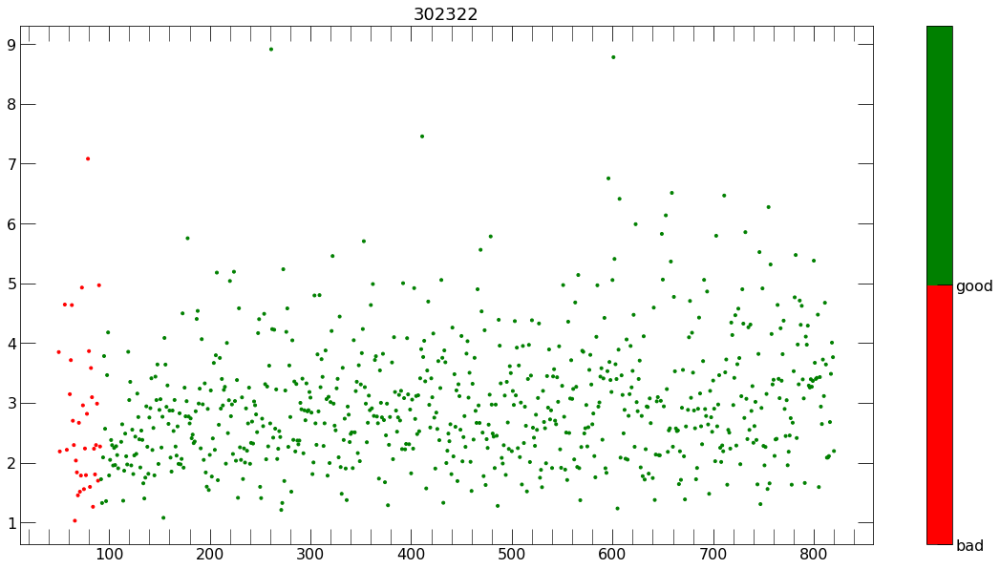

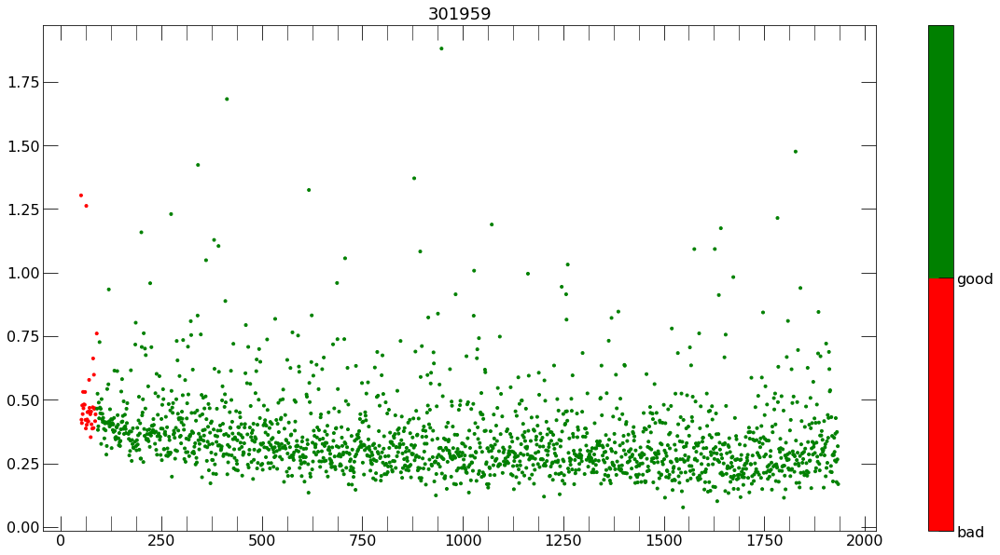

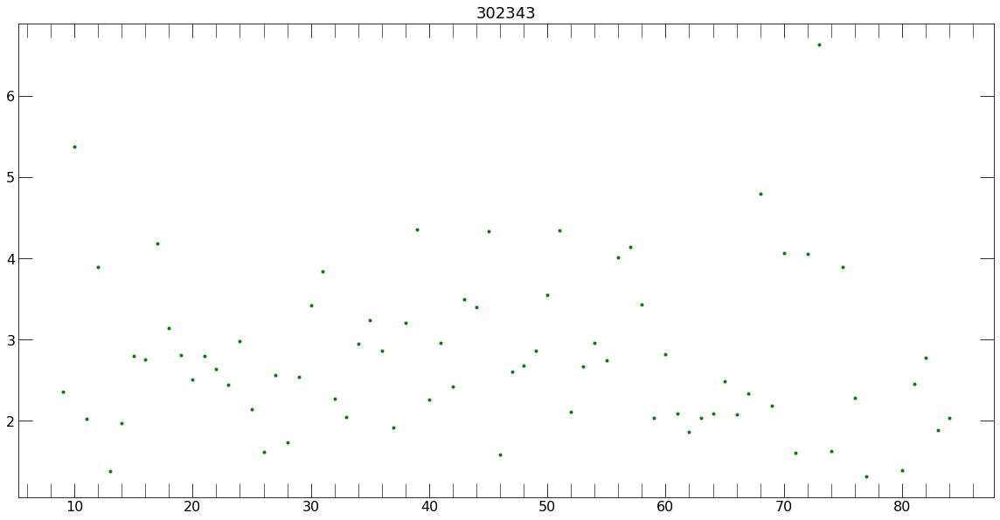

In [21]:
colors = ['red','green']
ticks = ['bad','good']

plt.figure(figsize=[20,10])
for l in range(len(labels)):
    plt.scatter(lumis[l],lumi_errors[l],marker='.',c=labels[l], cmap=matplotlib.colors.ListedColormap(colors))
cb = plt.colorbar()
loc = np.arange(0,1,1/float(len(colors)))
cb.set_ticks(loc)
cb.set_ticklabels(ticks)    
plt.show()

for l in range(len(labels)):
    plt.figure(figsize=[20,10])
    plt.title(runs[l])
    if np.mean(labels[l]) == 1:
        plt.plot(lumis[l],lumi_errors[l],'g.')
    else:
        plt.scatter(lumis[l],lumi_errors[l],marker='.',c=labels[l], cmap=matplotlib.colors.ListedColormap(colors))
        cb = plt.colorbar()
        loc = np.arange(0,1,1/float(len(colors)))
        cb.set_ticks(loc)
        cb.set_ticklabels(ticks)
    plt.show()

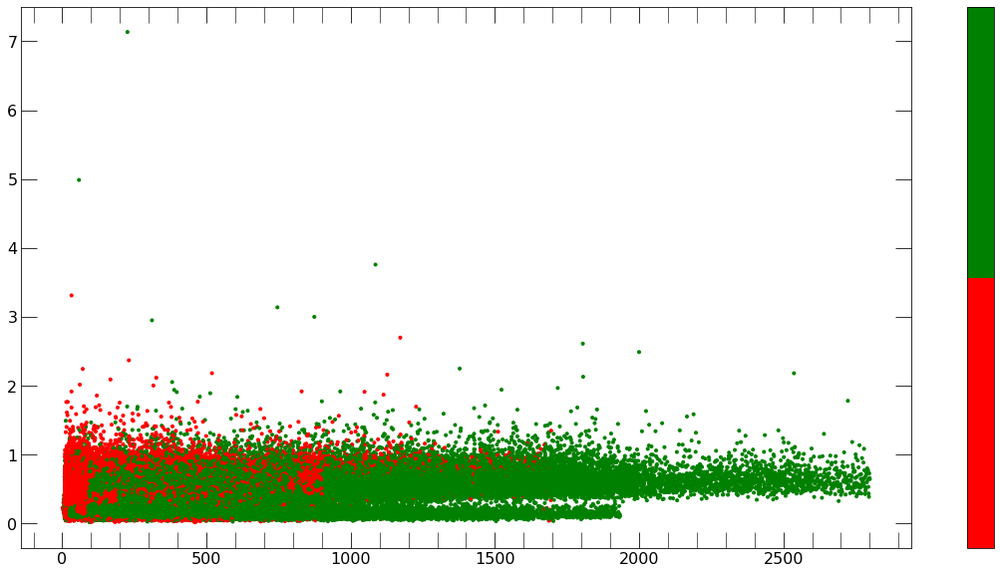

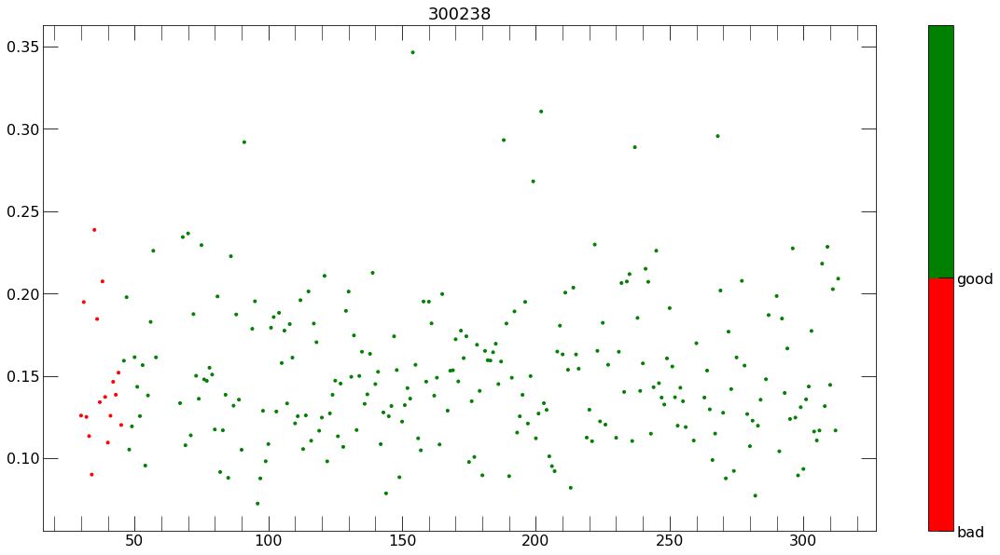

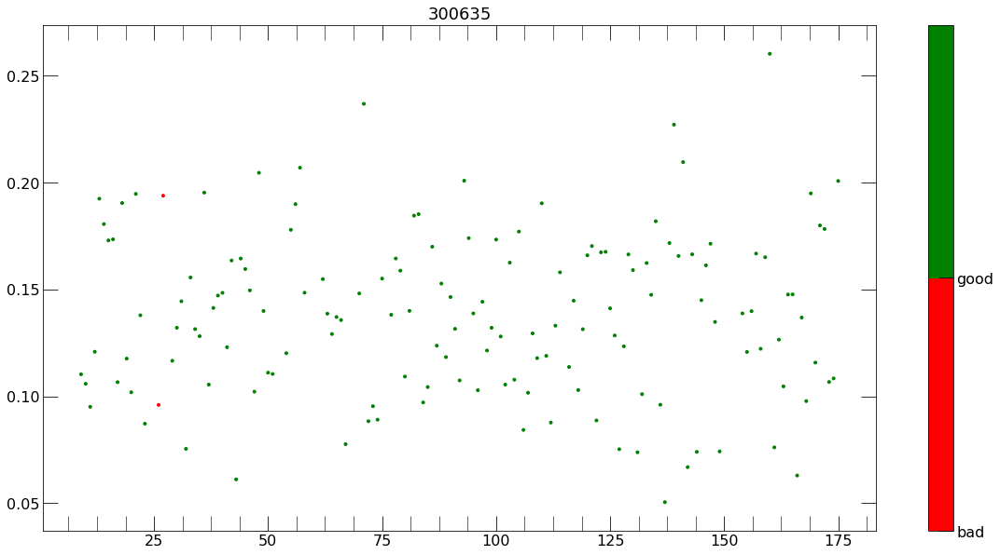

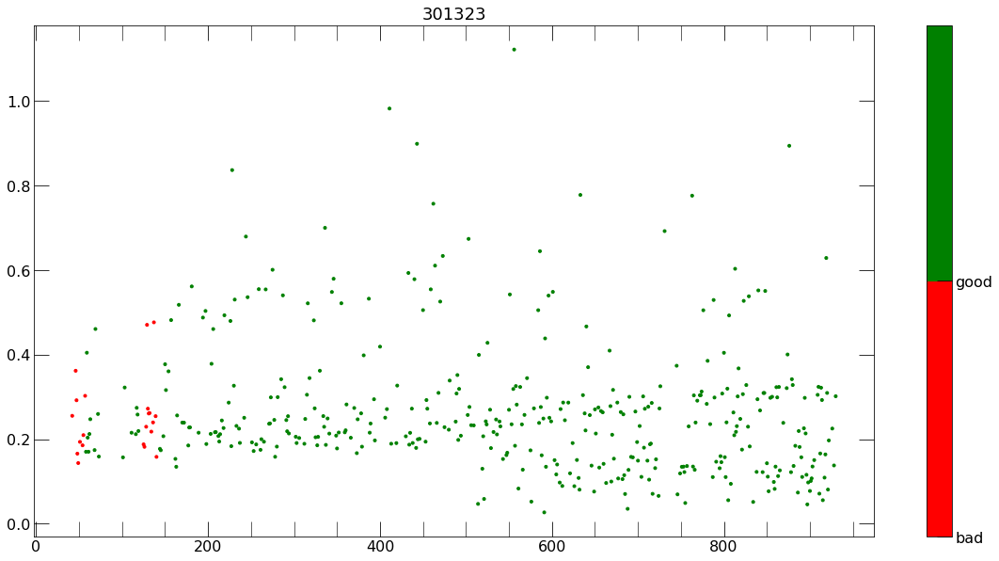

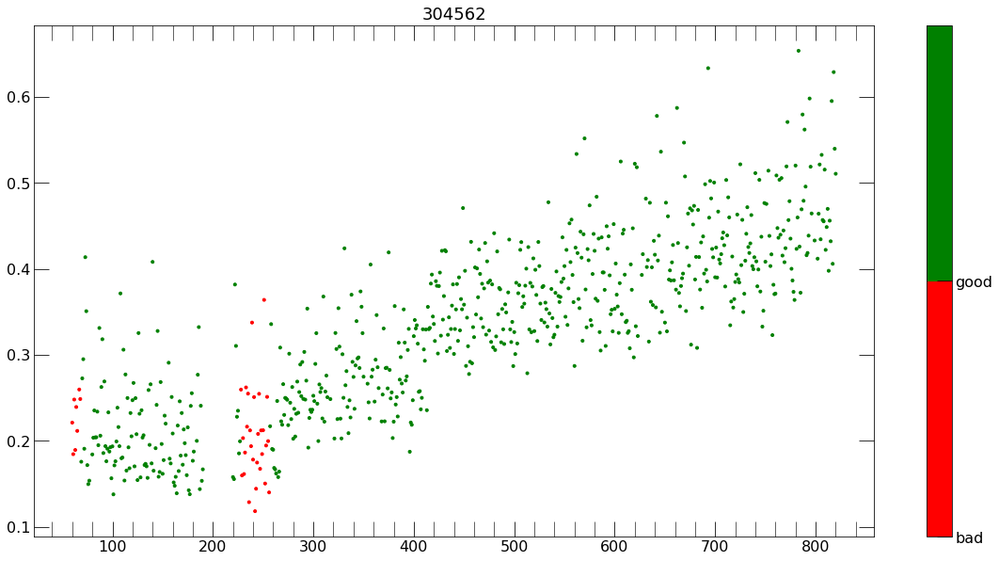

...

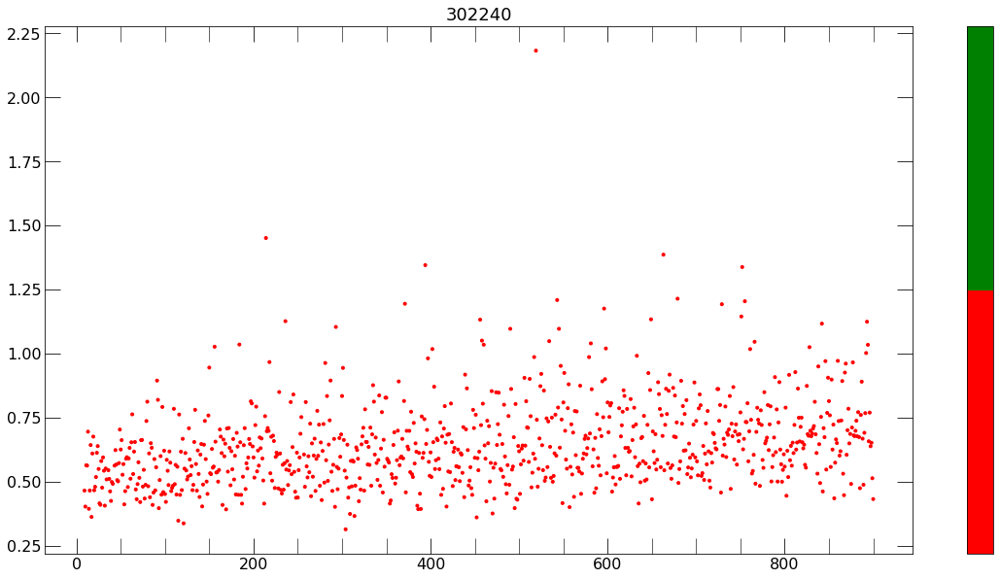

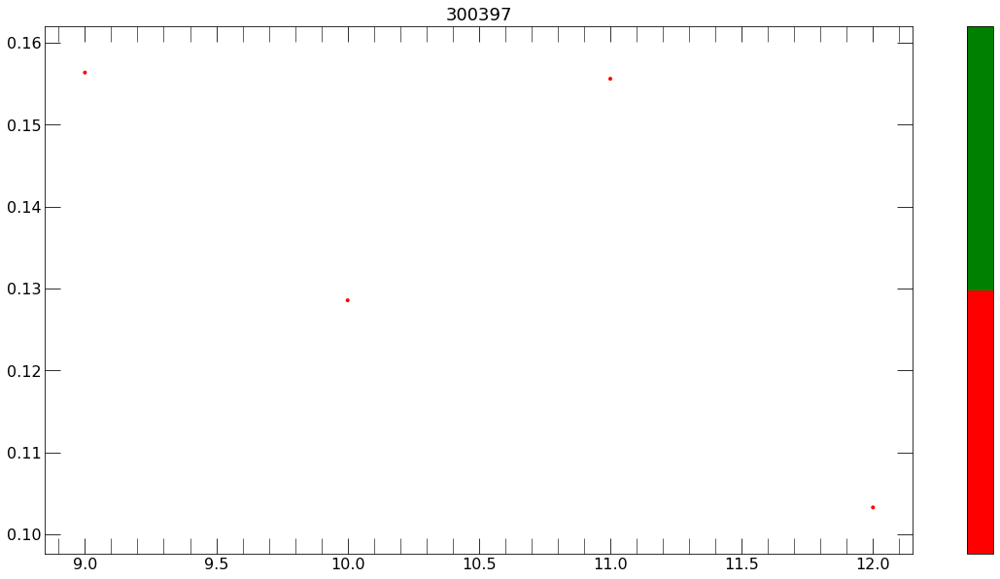

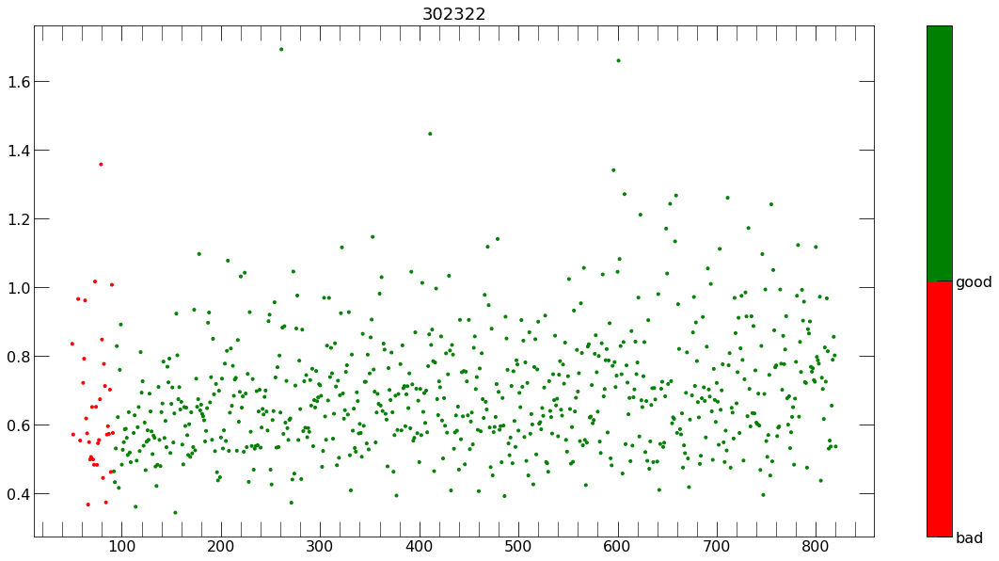

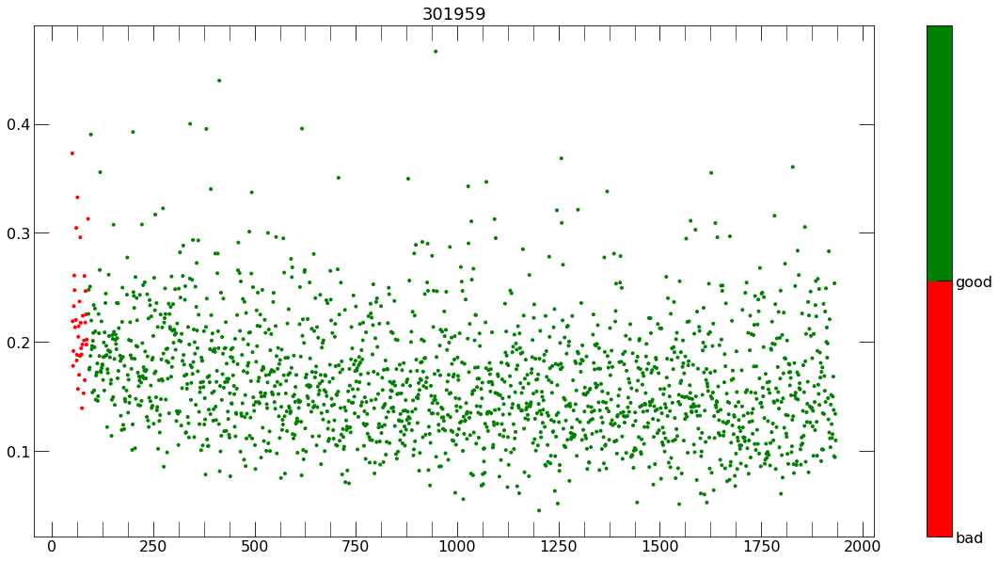

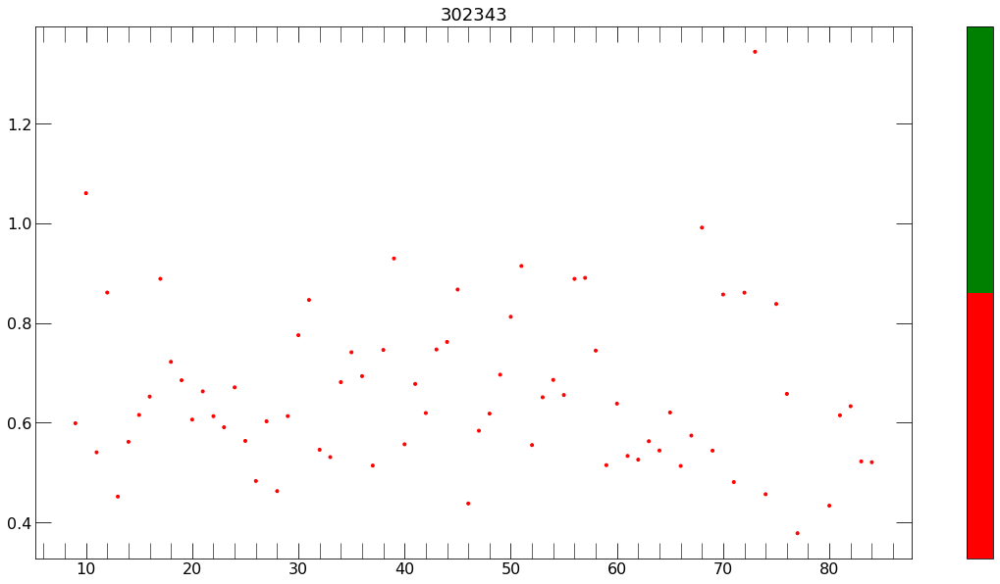

In [22]:
colors = ['red','green']
ticks = ['bad','good']

plt.figure(figsize=[20,10])
for l in range(len(labels)):
    plt.scatter(lumis[l],lumi_errors_mean[l],marker='.',c=labels[l], cmap=matplotlib.colors.ListedColormap(colors))
cb = plt.colorbar()
loc = np.arange(0,max(labels[1]),max(labels[1])/float(len(colors)))
cb.set_ticks(loc)
cb.set_ticklabels(colors)    
plt.show()

for l in range(len(labels)):
    plt.figure(figsize=[20,10])
    plt.title(runs[l])
    plt.scatter(lumis[l],lumi_errors_mean[l],marker='.',c=labels[l], cmap=matplotlib.colors.ListedColormap(colors))
    cb = plt.colorbar()
    loc = np.arange(0,1,1/float(len(colors)))
    cb.set_ticks(loc)
    cb.set_ticklabels(ticks)
    plt.show()

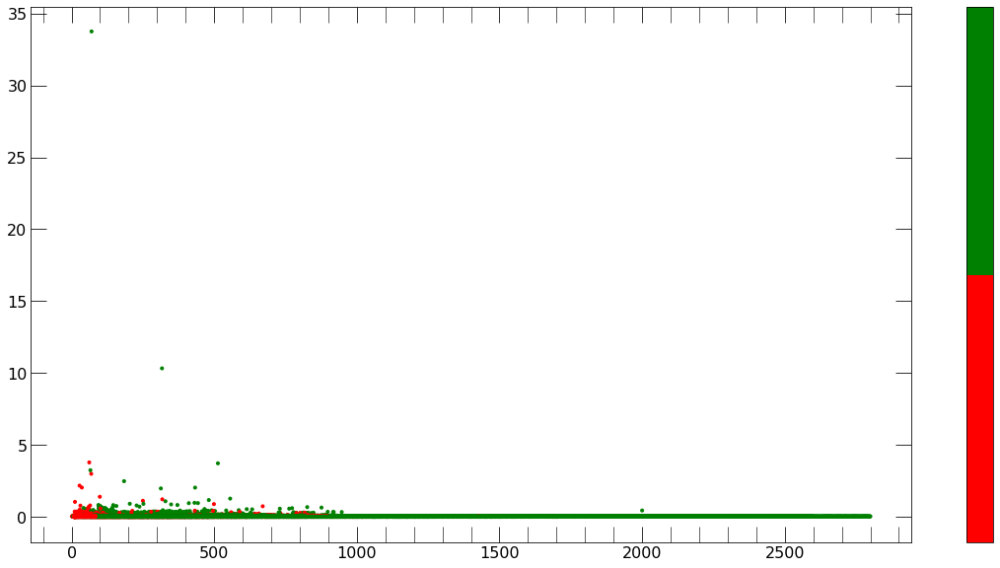

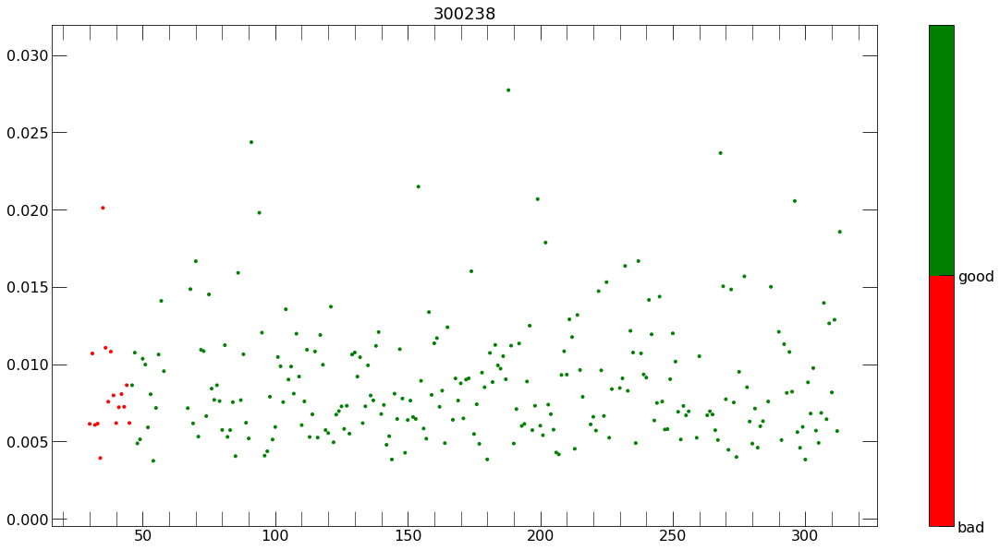

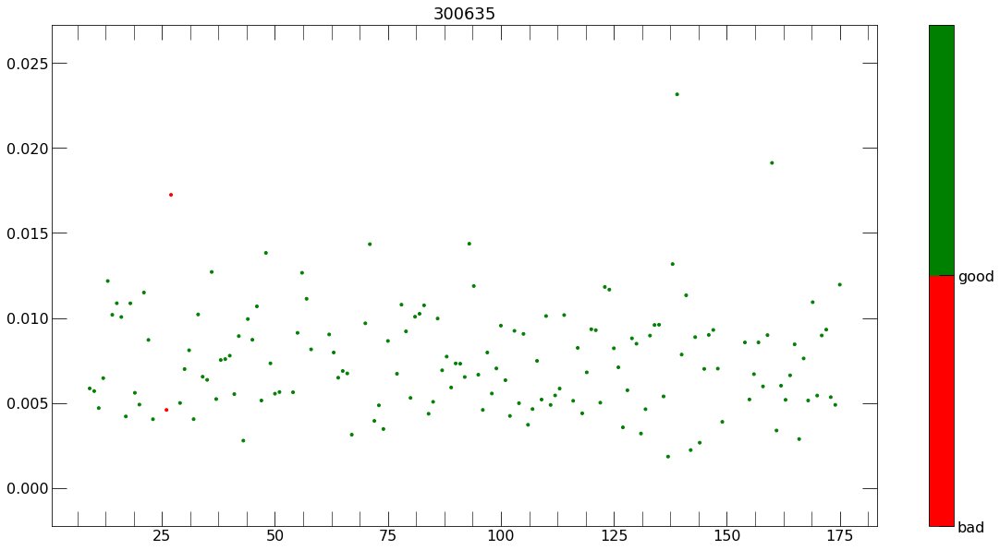

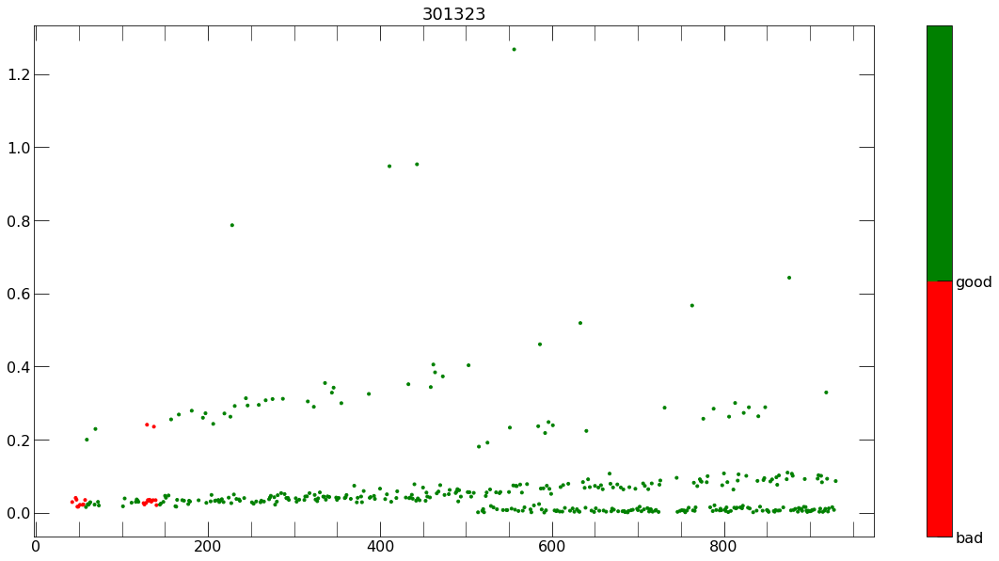

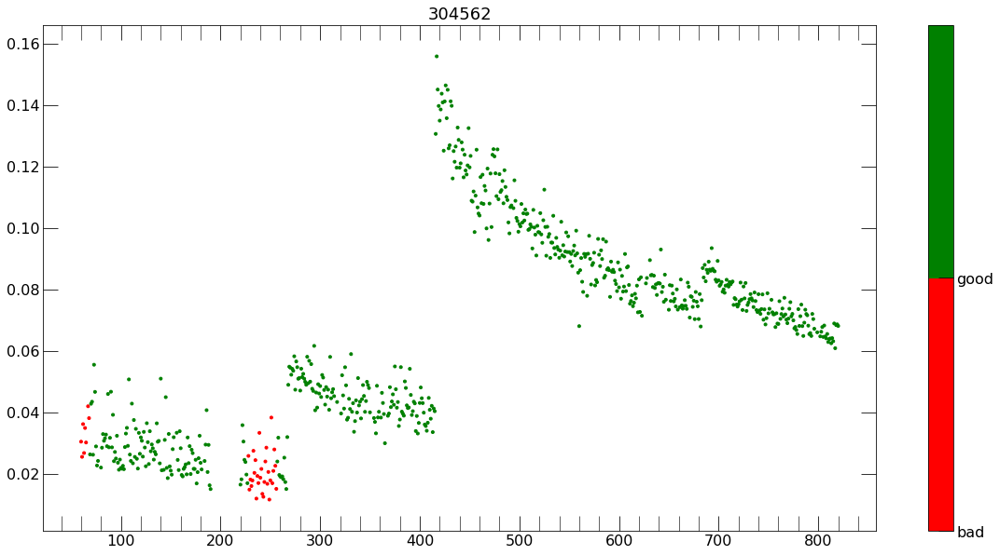

...

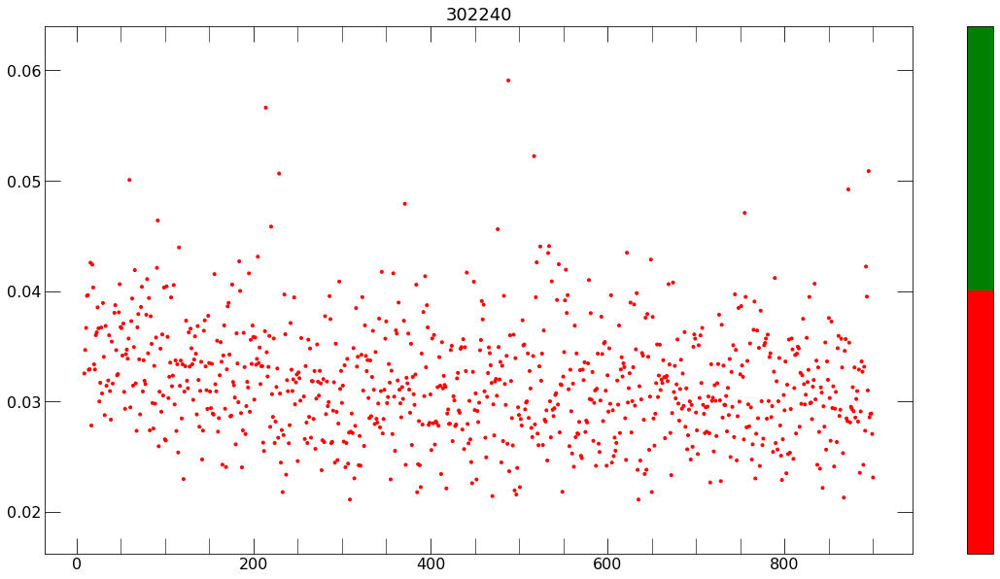

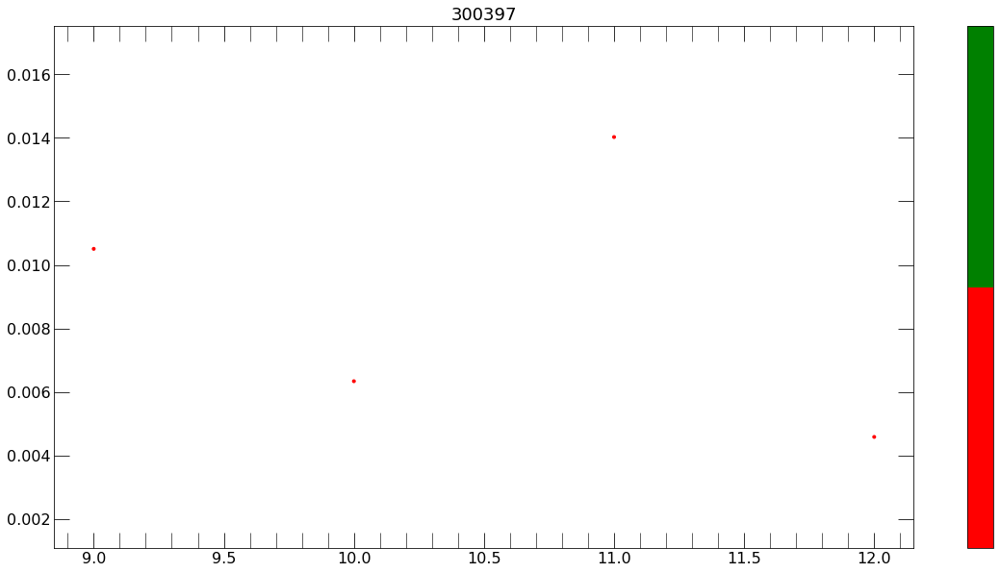

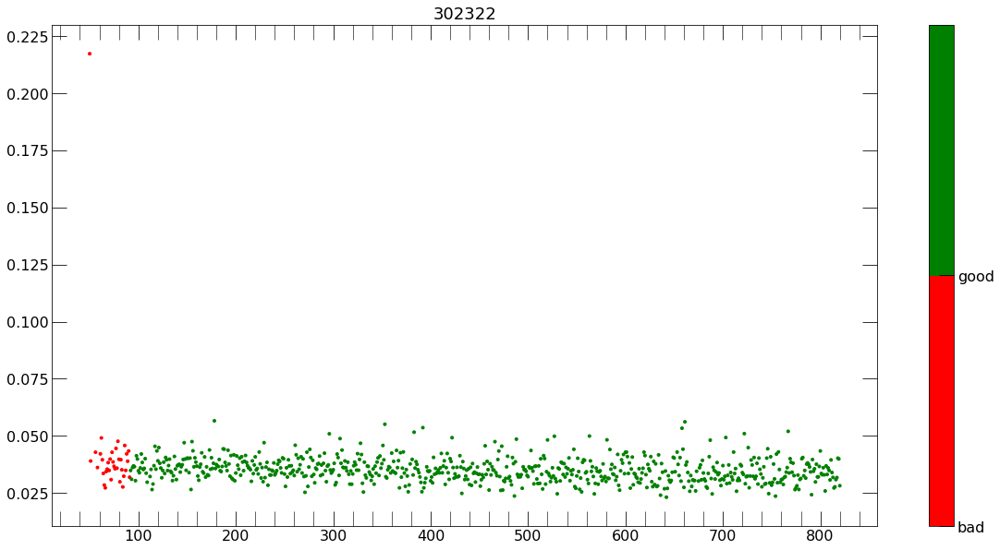

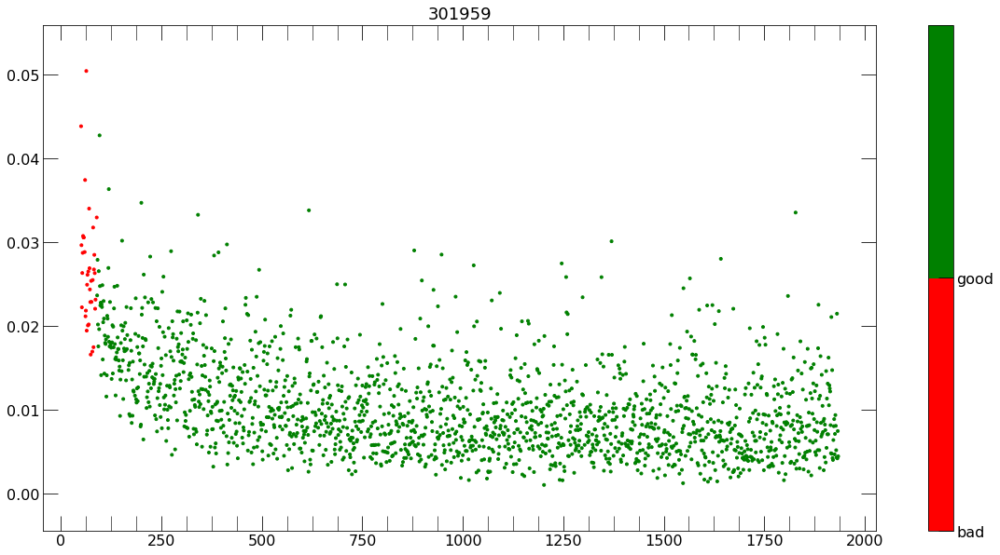

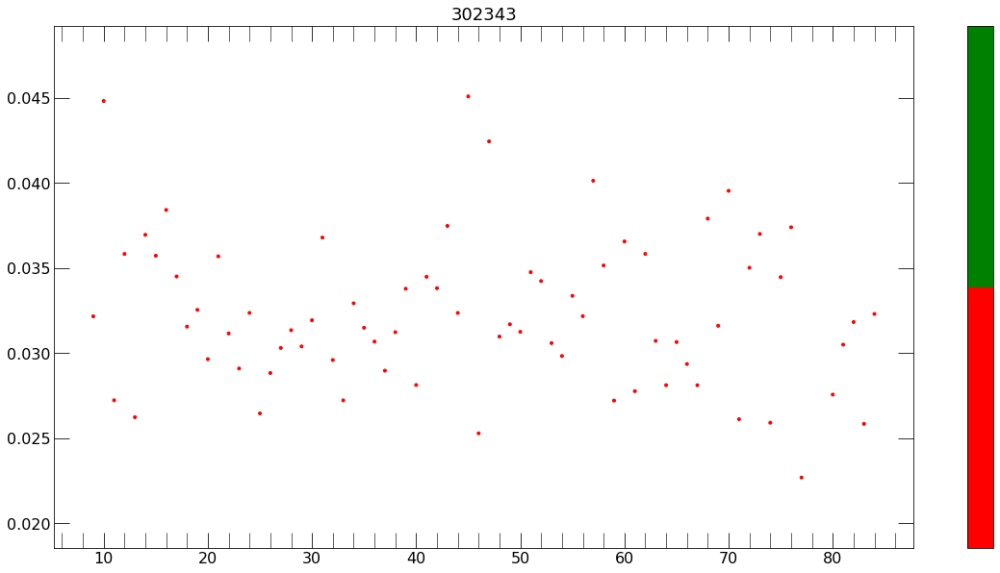

In [23]:
colors = ['red','green']
ticks = ['bad','good']

plt.figure(figsize=[20,10])
for l in range(len(labels)):
    plt.scatter(lumis[l],lumi_errors_square[l],marker='.',c=labels[l], cmap=matplotlib.colors.ListedColormap(colors))
cb = plt.colorbar()
loc = np.arange(0,max(labels[1]),max(labels[1])/float(len(colors)))
cb.set_ticks(loc)
cb.set_ticklabels(colors)    
plt.show()

for l in range(len(labels)):
    plt.figure(figsize=[20,10])
    plt.title(runs[l])
    plt.scatter(lumis[l],lumi_errors_square[l],marker='.',c=labels[l], cmap=matplotlib.colors.ListedColormap(colors))
    cb = plt.colorbar()
    loc = np.arange(0,1,1/float(len(colors)))
    cb.set_ticks(loc)
    cb.set_ticklabels(ticks)
    plt.show()

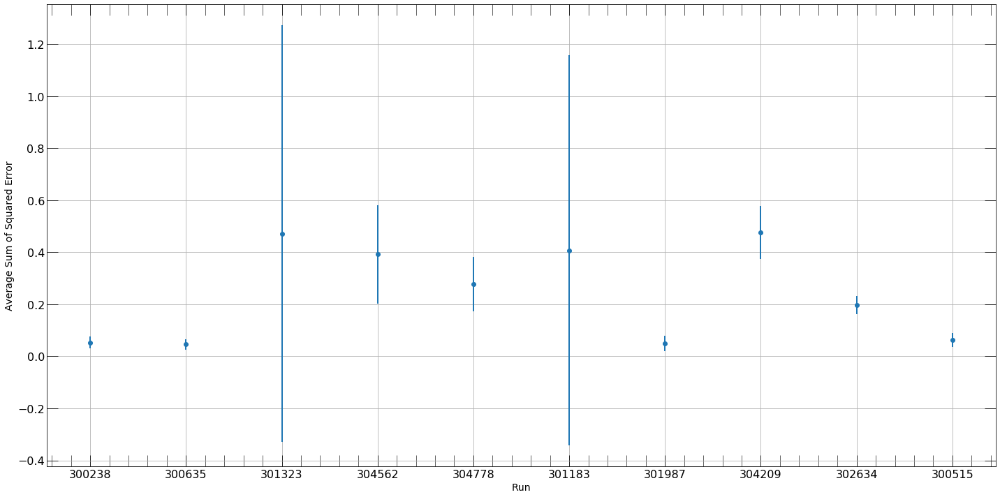

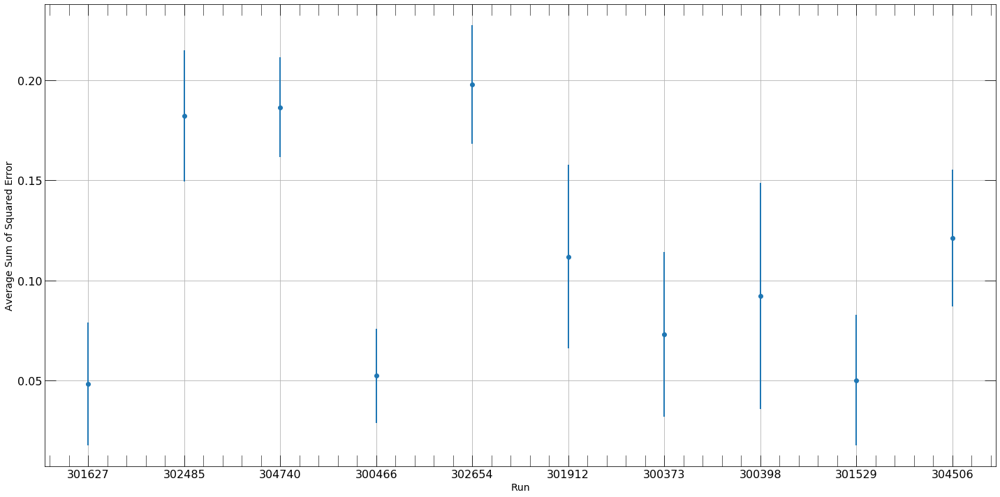

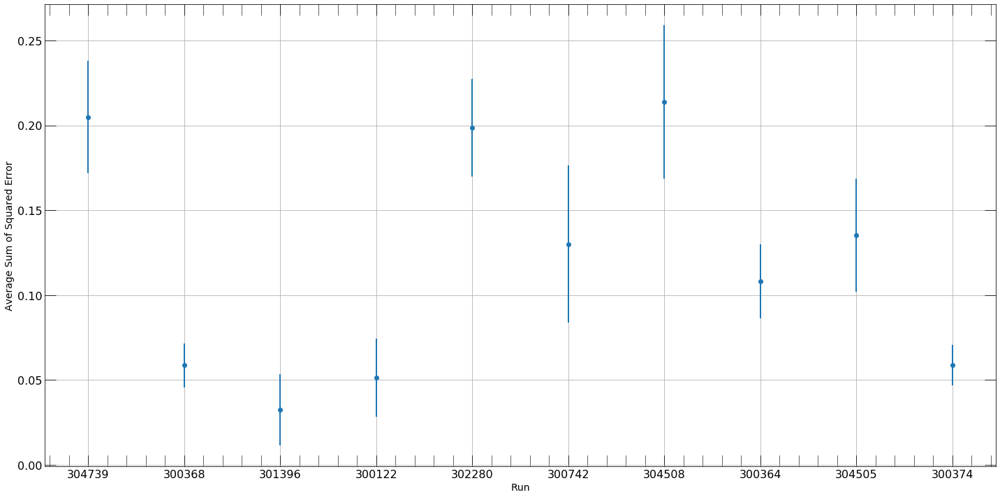

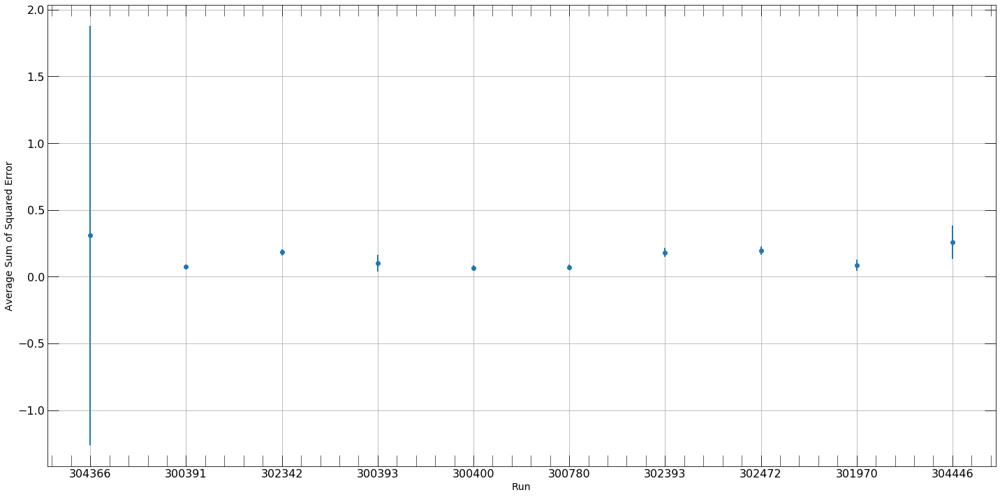

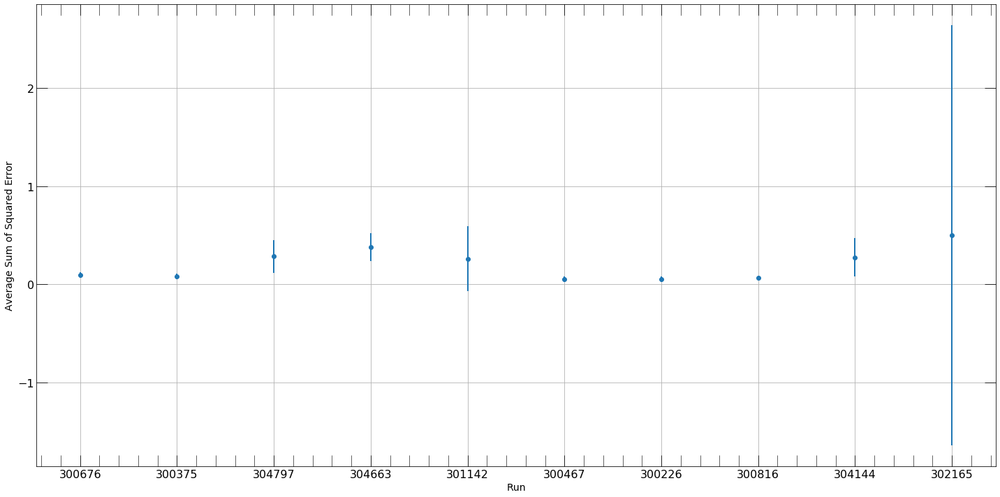

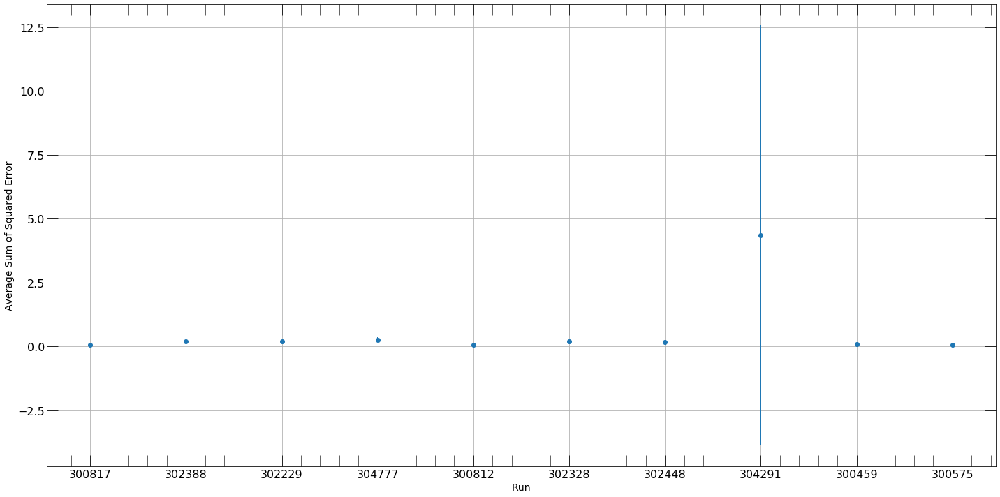

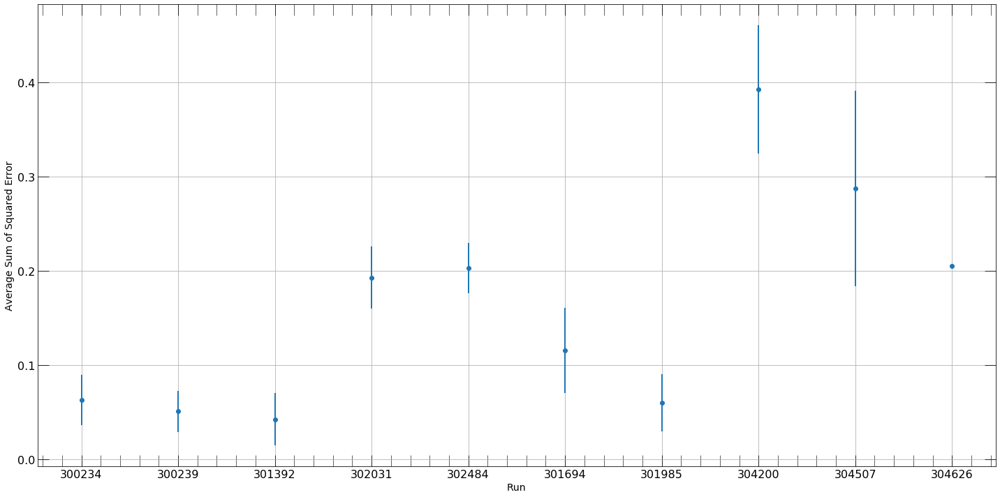

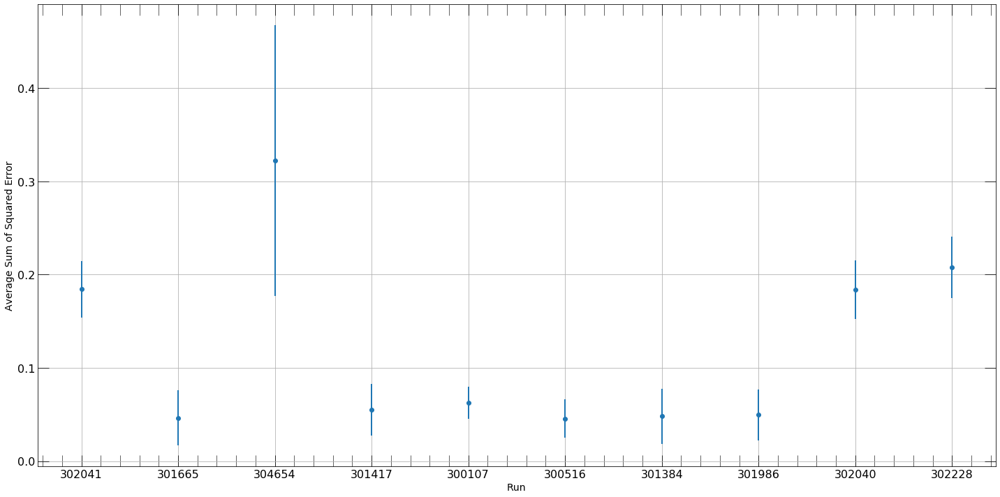

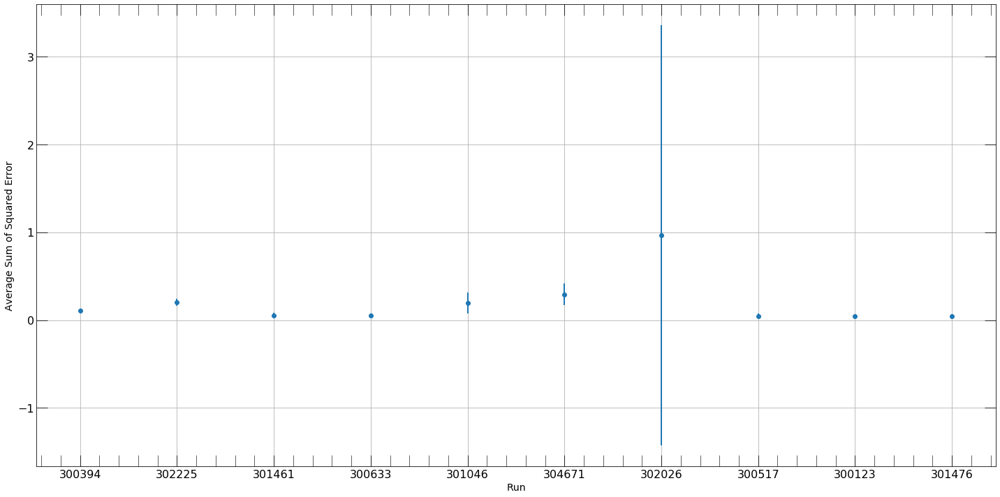

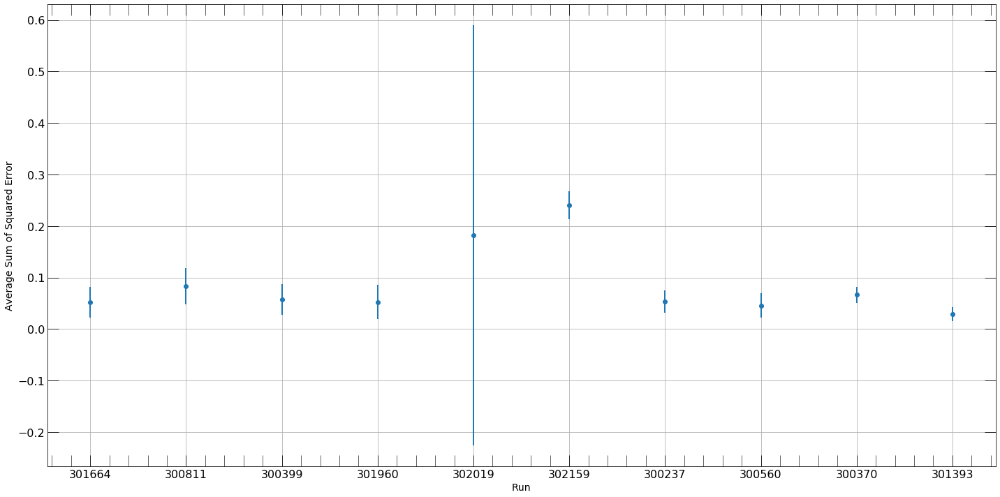

In [24]:
i = 0
while i < 10:
    plt.figure(figsize=[20,10])

    ax = plt.axes()

    l = np.linspace(1,len(runs[i*10:(i+1)*10]),len(runs[i*10:(i+1)*10]))

    #ax.plot(l, mean_square[i*10:(i+1)*10], '.')
    ax.errorbar(l, mean_square[i*10:(i+1)*10], fmt='o', yerr=stdd_square[i*10:(i+1)*10])

    # Set the tick positions
    ax.set_xticks(l,)
    # Set the tick labels
    ax.set_xticklabels(runs[i*10:(i+1)*10])

    plt.xlabel('Run')
    plt.ylabel('Average Sum of Squared Error')

    plt.tight_layout()

    ax.grid()
    
    i+=1

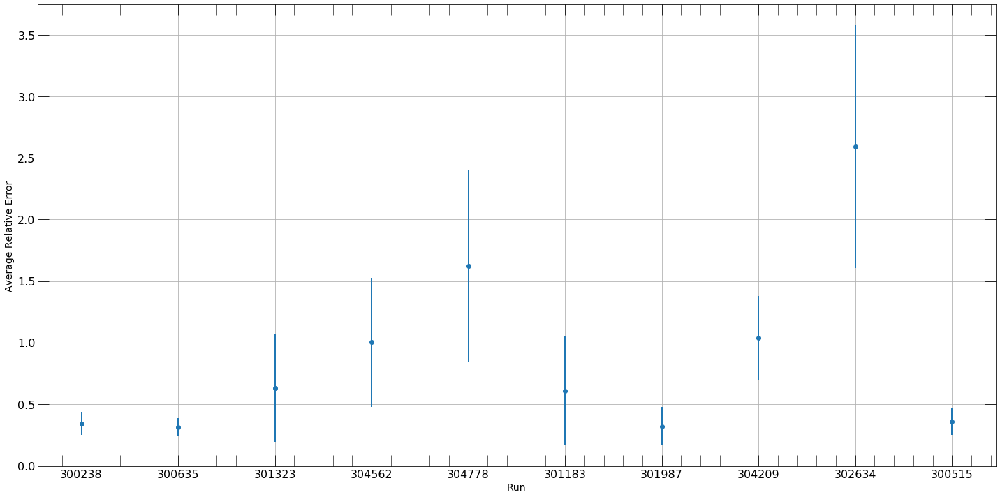

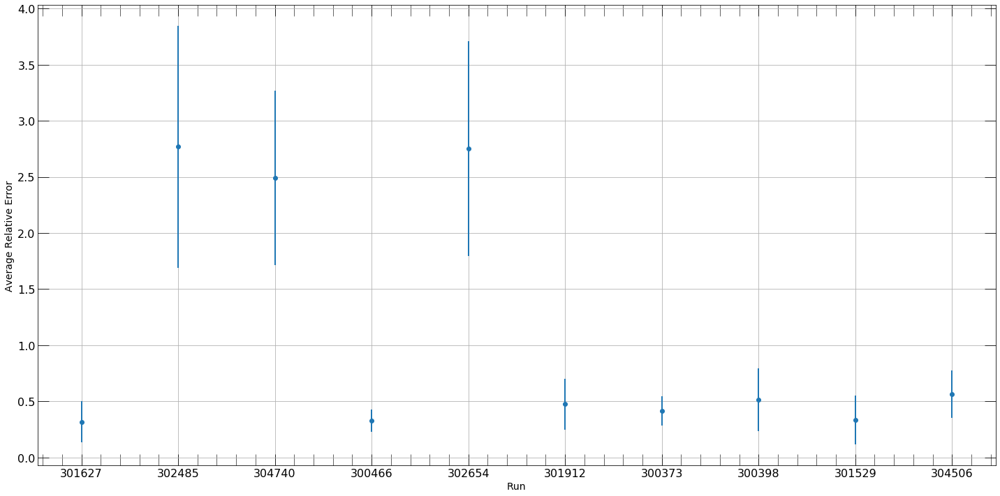

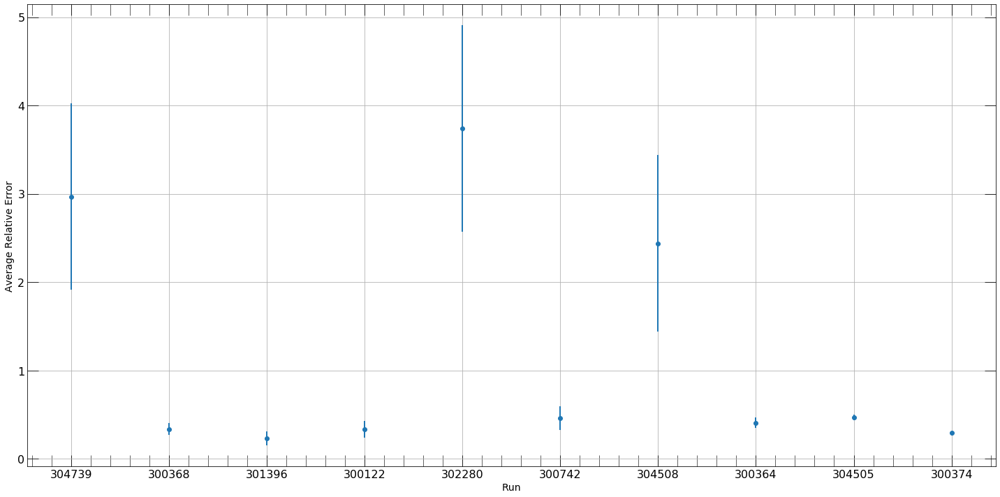

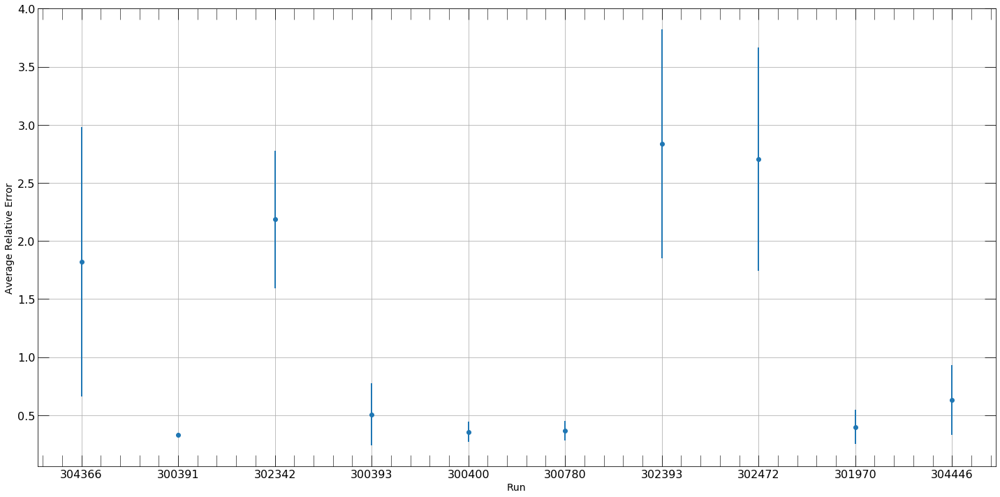

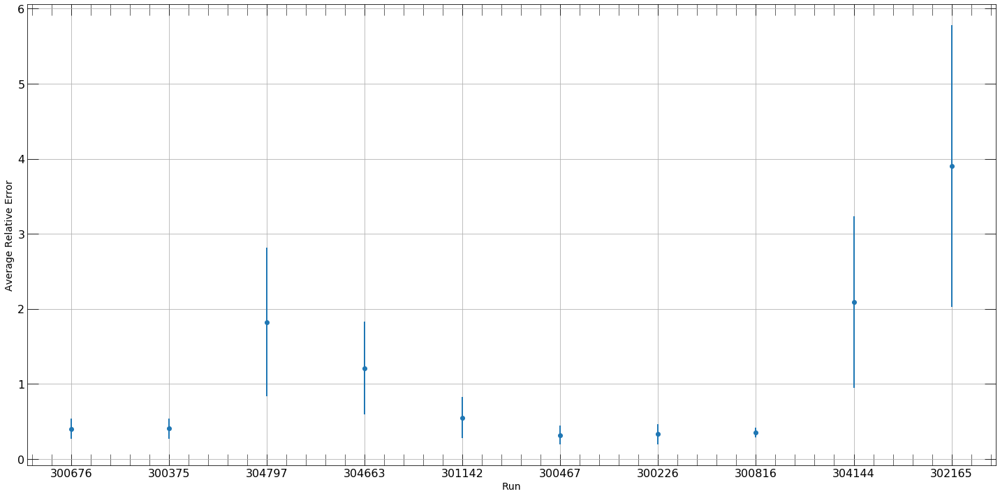

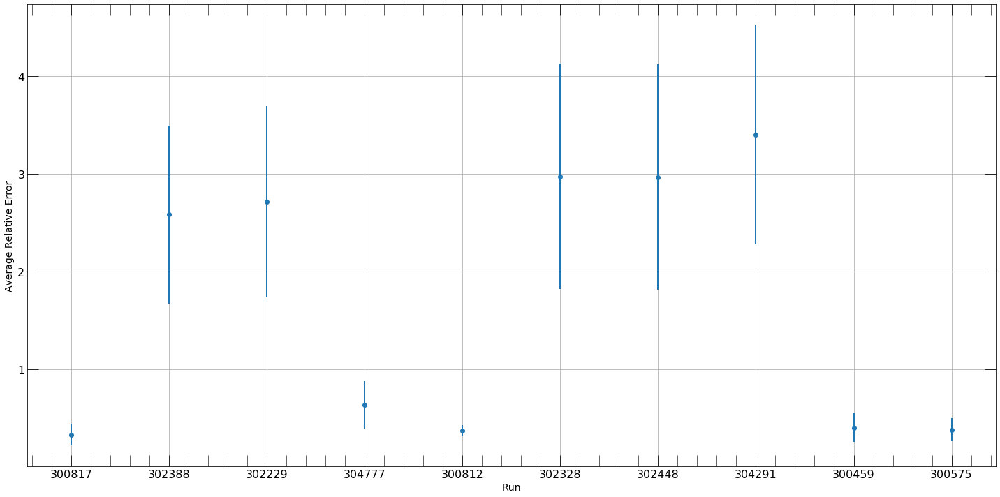

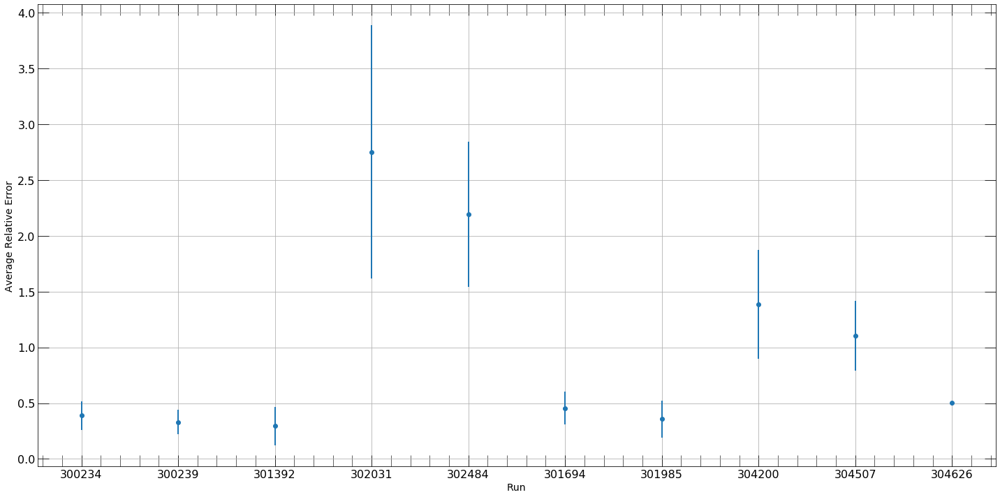

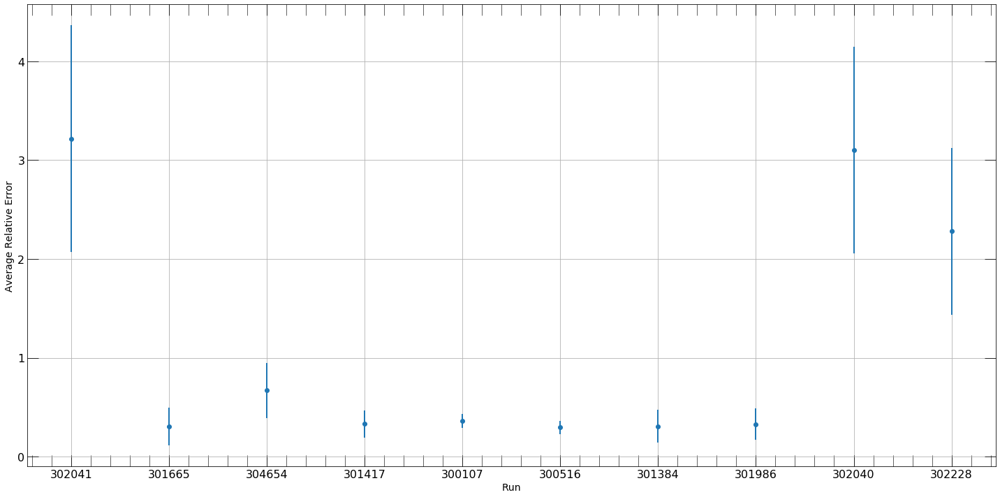

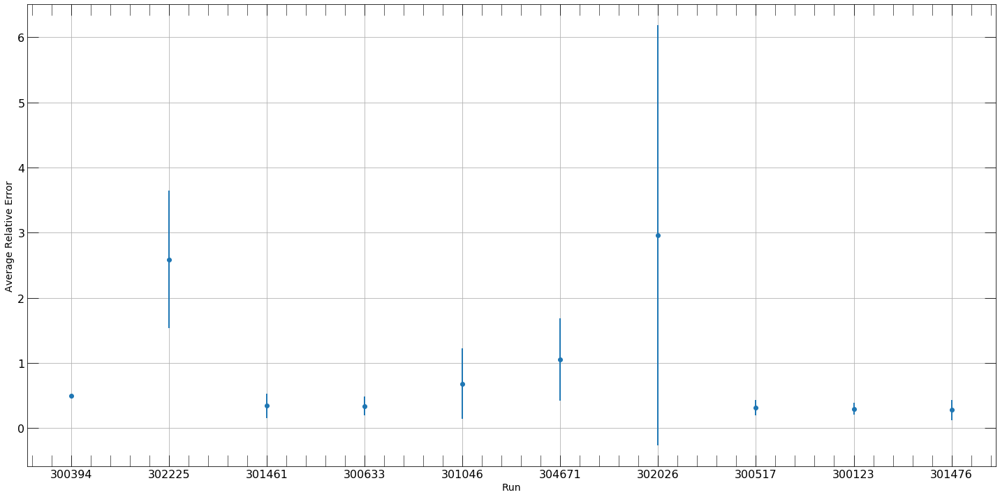

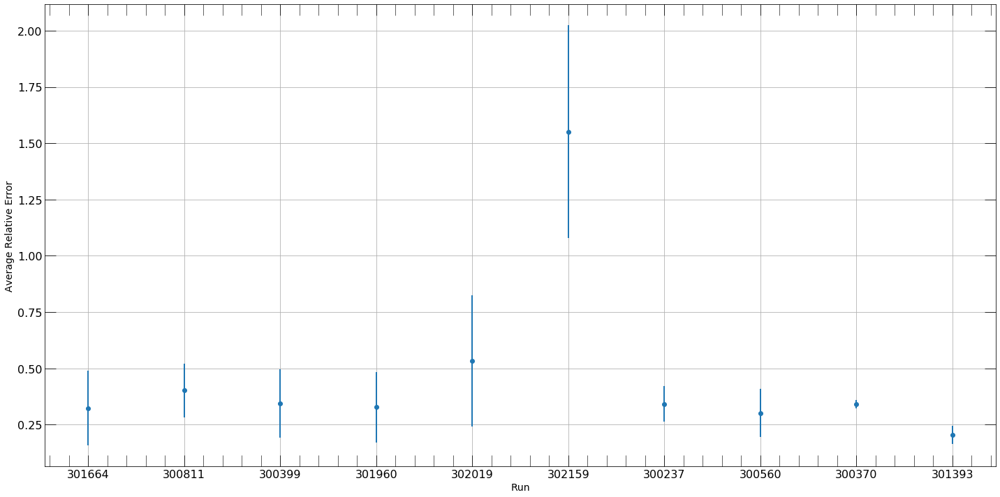

In [25]:
i = 0
while i < 10:
    plt.figure(figsize=[20,10])

    ax = plt.axes()

    l = np.linspace(1,len(runs[i*10:(i+1)*10]),len(runs[i*10:(i+1)*10]))

    #ax.plot(l, mean_max[i*10:(i+1)*10], '.')
    ax.errorbar(l, mean_max[i*10:(i+1)*10], fmt='o', yerr=stdd_max[i*10:(i+1)*10])

    # Set the tick positions
    ax.set_xticks(l,)
    # Set the tick labels
    ax.set_xticklabels(runs[i*10:(i+1)*10])

    plt.xlabel('Run')
    plt.ylabel('Average Relative Error')

    plt.tight_layout()

    ax.grid()
    
    i+=1

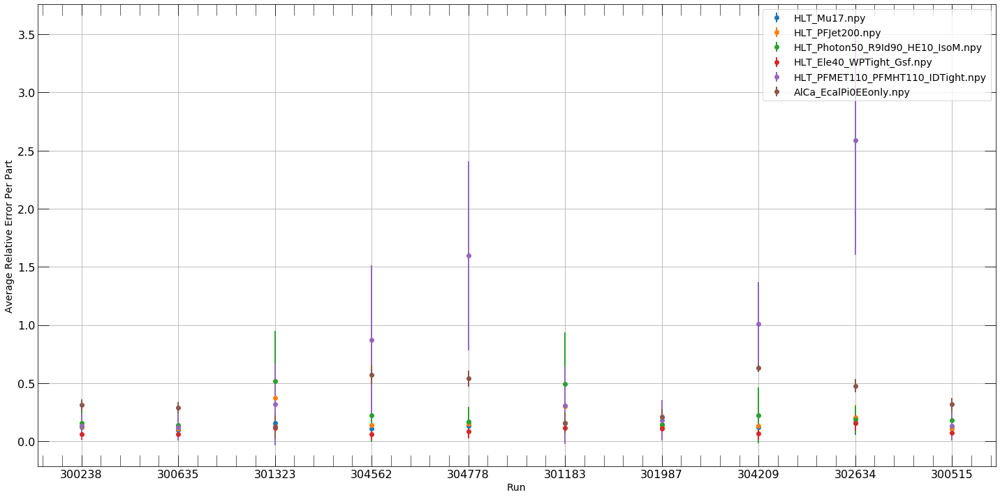

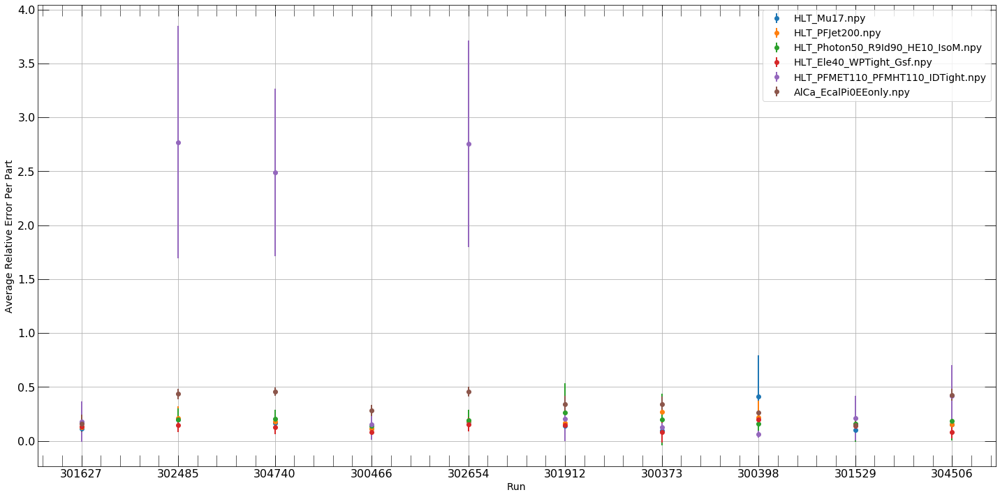

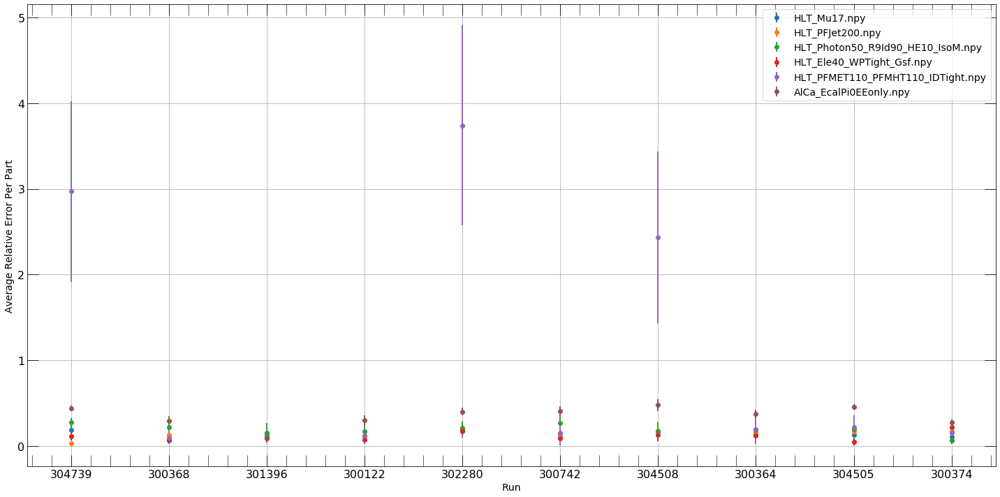

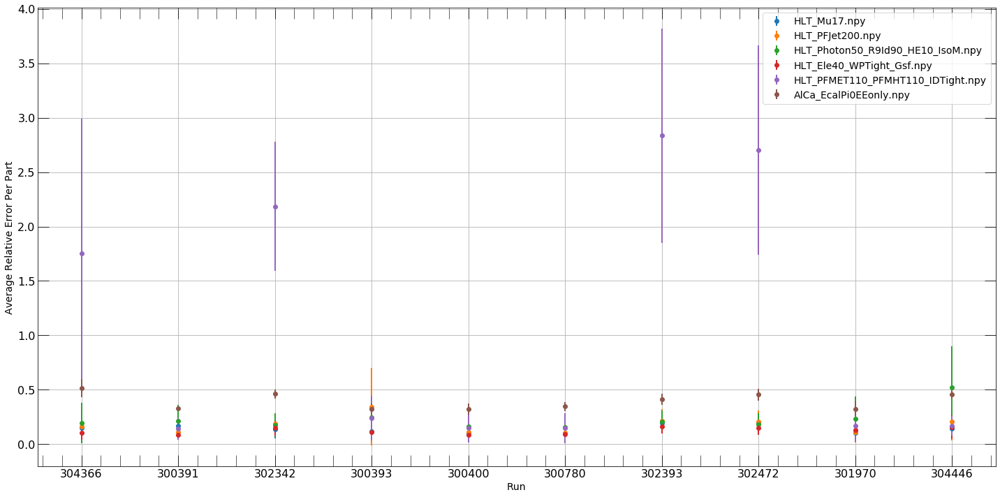

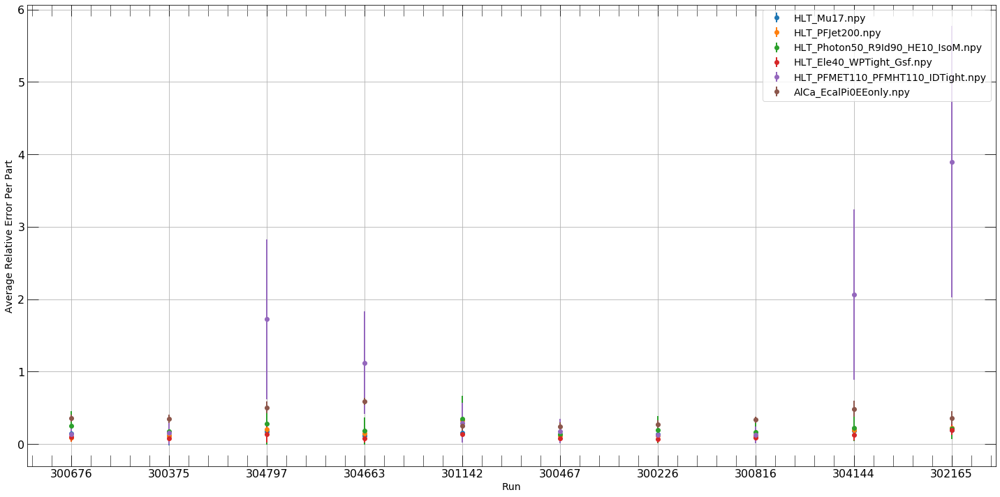

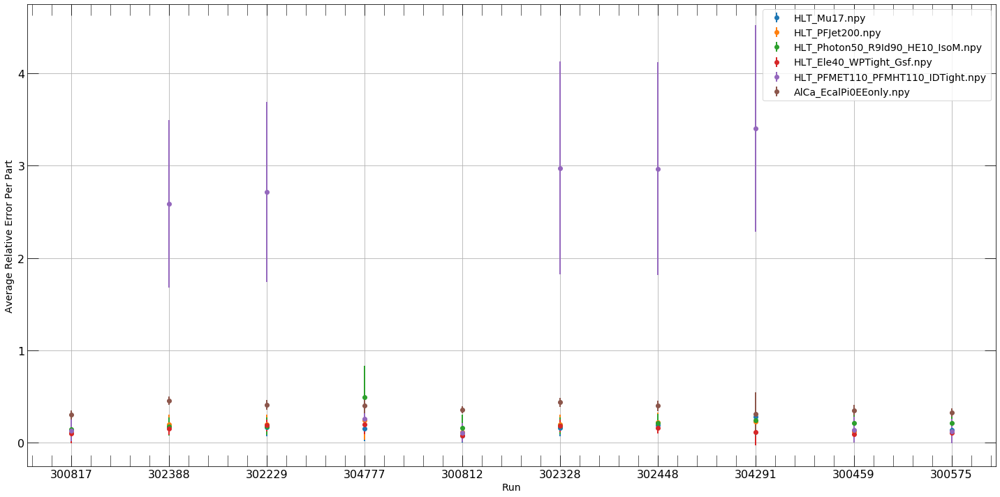

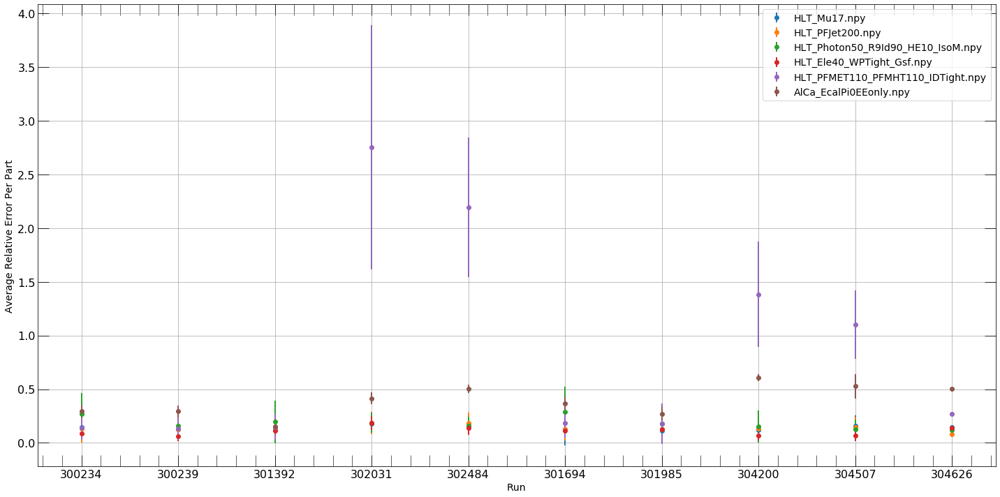

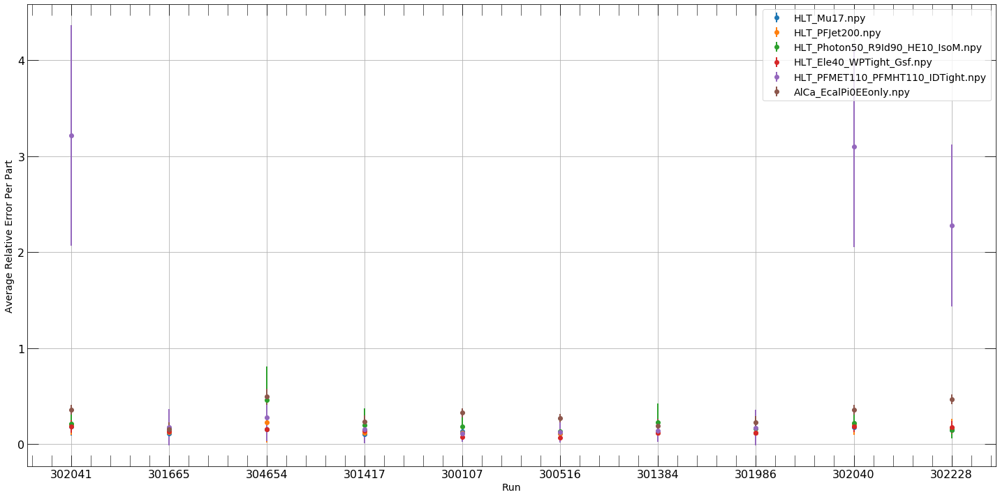

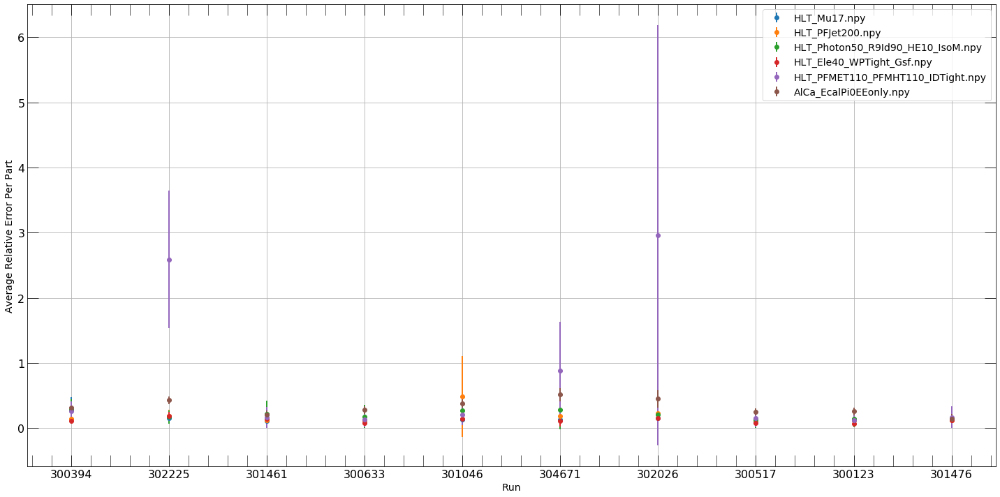

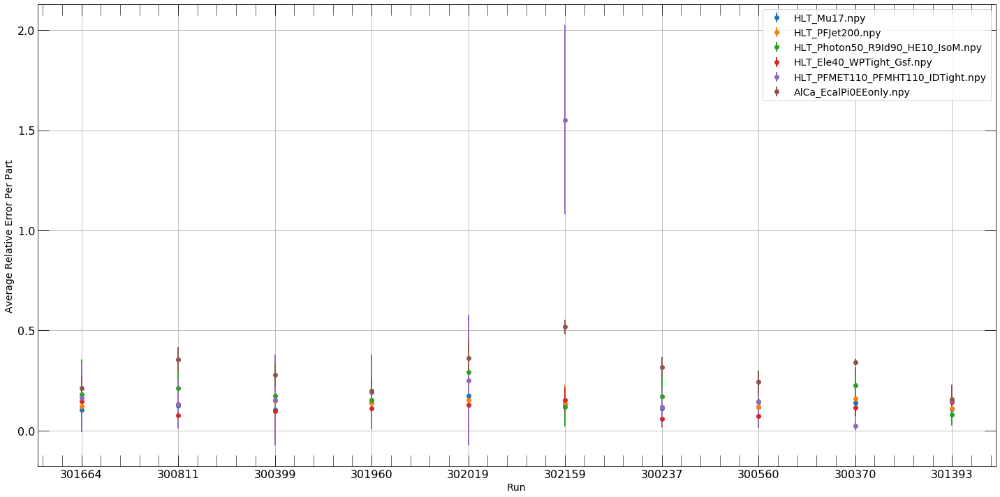

In [26]:
i = 0

paths = good_data['HLT']

while i < 10:
    plt.figure(figsize=[20,10])

    ax = plt.axes()

    l = np.linspace(1,len(runs[i*10:(i+1)*10]),len(runs[i*10:(i+1)*10]))

    #ax.plot(l, mean_per_part[i*10:(i+1)*10], '.')
    for j in range(num_rates):
        ax.errorbar(l, mean_per_part[j][i*10:(i+1)*10], fmt='o', yerr=stdd_per_part[j][i*10:(i+1)*10],label=paths[j])

    # Set the tick positions
    ax.set_xticks(l,)
    # Set the tick labels
    ax.set_xticklabels(runs[i*10:(i+1)*10])

    plt.legend()
    
    plt.xlabel('Run')
    plt.ylabel('Average Relative Error Per Part')

    plt.tight_layout()

    ax.grid()
    
    i+=1

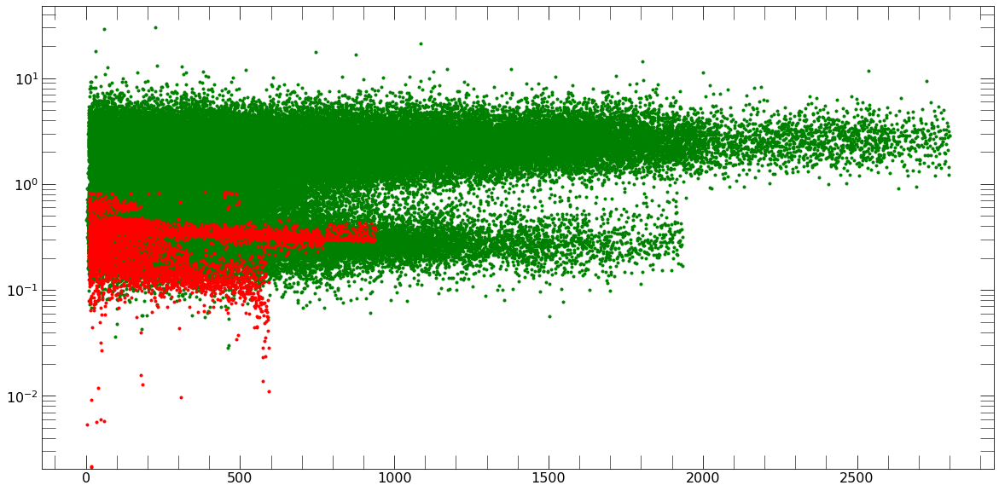

In [48]:
colors = ['red','green']
ticks = ['bad','good']

plt.figure(figsize=[20,10])
for l in range(len(labels)):
    if l < num_good_runs:
        plt.scatter(lumis[l],lumi_errors[l],marker='.',c='g')
    else:
        plt.scatter(lumis[l],lumi_errors[l],marker='.',c='r')
plt.yscale('log')
plt.show()

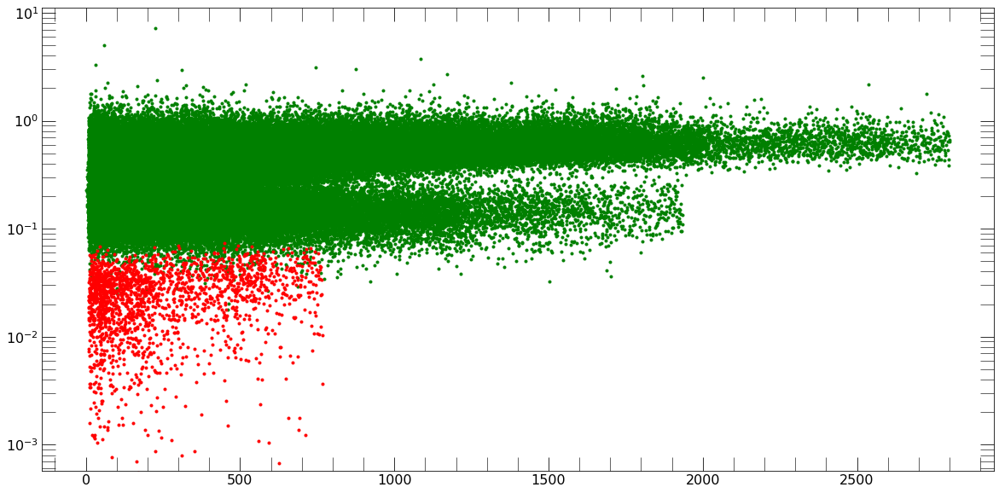

In [49]:
colors = ['red','green']
ticks = ['bad','good']

plt.figure(figsize=[20,10])
for l in range(len(labels)):
    if l < num_good_runs:
        plt.scatter(lumis[l],lumi_errors_mean[l],marker='.',c='g')
    else:
        plt.scatter(lumis[l],lumi_errors_mean[l],marker='.',c='r')
plt.yscale('log')
plt.show()

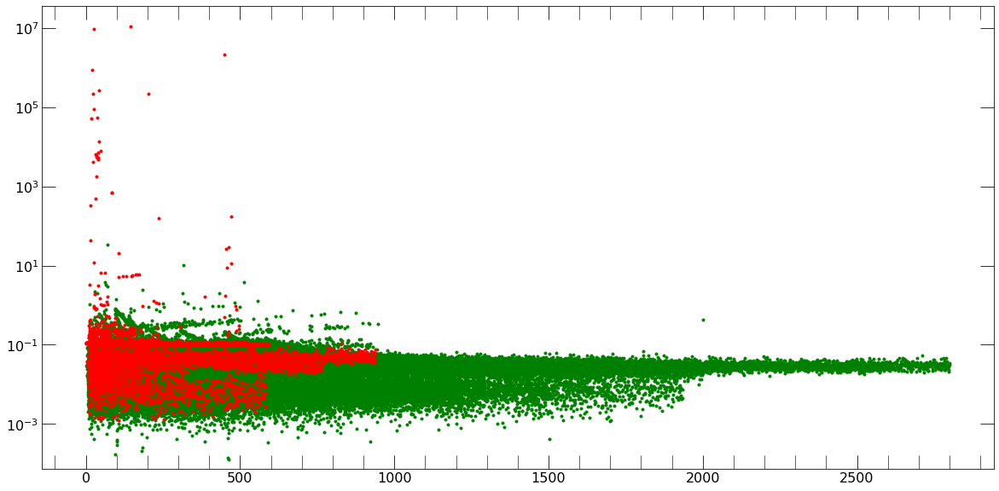

In [50]:
colors = ['red','green']
ticks = ['bad','good']

plt.figure(figsize=[20,10])
for l in range(len(labels)):
    if l < num_good_runs:
        plt.scatter(lumis[l],lumi_errors_square[l],marker='.',c='g')
    else:
        plt.scatter(lumis[l],lumi_errors_square[l],marker='.',c='r')
plt.yscale('log')
plt.show()